# Catboost Regression
- catboost regression CV
- Calculate the aggregated effects of 10 iterations of CatBoost + SHAP interpretation

In [48]:
import numpy as np
import pandas as pd
import os
import copy
import seaborn as sns
import matplotlib.pyplot as plt
from itertools import cycle
from random import choice
import copy
from sklearn.model_selection import train_test_split
from sklearn import preprocessing

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import time
from catboost import CatBoostRegressor, Pool, cv
import shap
import copy
import random
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler

In [3]:
# input for cadss regression for ketamine
x_cad= pd.read_csv('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Input_ket_CADSS_standardized.csv')
y_cad=pd.read_csv('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Y_CADSS_ket.csv')
train_data=x_cad.drop(columns=['Unnamed: 0'])

In [4]:
train_data

,5746_25,6026_25,5744_25,5379_25,5373_25,2529_25,3635_25,2997_25,2387_25,2417_25,...,5746_s32,6026_s32,5744_s32,5379_s32,5373_s32,2529_s32,3635_s32,2997_s32,2387_s32,2417_s32
0,0.080754,0.190333,0.929657,-0.700847,-1.019170,-0.704803,-0.542567,0.053024,-0.985108,-0.603843,...,-0.516708,0.262513,0.230023,0.181700,-1.299156,-0.367029,0.223769,0.679025,-0.332973,0.320166
1,0.023088,0.654398,0.935484,-0.678420,-0.802763,-0.252052,-0.968072,-0.802526,-0.981082,-0.031534,...,0.587512,-0.890869,-0.254998,0.073980,1.086021,-0.073576,0.178494,-0.615287,-0.424351,0.395442
2,0.028632,0.359817,-0.391878,-0.874543,0.232622,-0.911904,0.484598,0.009072,0.513476,0.770034,...,-0.321585,-0.333410,-0.857593,0.008259,-0.249855,0.276207,-0.614523,-0.042155,-0.023040,-0.189156
3,-0.131350,-0.450513,1.725240,1.463272,-0.280427,0.928350,2.743382,0.879090,-1.554837,-0.065543,...,-0.208048,0.441469,1.259124,1.363093,-0.672614,0.620291,-0.467114,0.803814,-0.139917,-0.171964
4,-0.901021,1.465850,0.904596,0.047803,-0.644389,-2.562106,0.384758,-0.862184,-0.005775,-0.985063,...,-0.230110,1.551339,0.374112,1.474913,0.378451,-0.154076,2.239496,1.880667,0.908705,0.286139
5,-0.493475,-0.724875,-1.150669,-0.287052,0.416146,-1.211524,-0.449846,-0.258190,0.197360,-1.032428,...,0.220638,-1.098936,1.016707,0.278537,-0.499403,-1.153817,-1.270706,-0.591310,0.217787,0.202071
6,-1.876550,-1.337528,0.292838,-1.316130,-0.805687,1.385988,0.088953,0.522919,0.897957,-0.280310,...,-1.193147,0.745938,0.043224,-1.634982,-1.319975,0.393097,0.283063,0.005958,1.002666,1.447251
7,-1.157964,-0.657137,0.462216,1.260910,0.008568,-0.362588,0.205579,0.535081,-0.679787,-0.015537,...,-0.294242,-1.085818,0.308436,0.311466,-0.634355,-0.407370,1.577965,-1.402025,0.271108,-0.039570
8,-0.497645,-1.247423,0.433119,-0.578375,0.423220,0.344242,0.262433,-0.559700,0.564594,2.518956,...,0.071527,-1.551079,0.675152,-0.967030,-0.049765,-1.443343,1.222242,-0.982233,1.487515,3.688788
9,1.040245,2.367617,1.001326,0.113452,-1.957812,-0.106313,-0.045867,-0.126461,-0.374933,-1.285604,...,0.142575,2.352908,2.399536,-0.728315,-1.806886,-0.685813,-0.246049,0.428849,-1.309823,-1.157168


In [109]:
!pip install ipywidgets

  Using cached https://files.pythonhosted.org/packages/56/a0/dbcf5881bb2f51e8db678211907f16ea0a182b232c591a6d6f276985ca95/ipywidgets-7.5.1-py2.py3-none-any.whl
  Using cached https://files.pythonhosted.org/packages/6c/7b/7ac231c20d2d33c445eaacf8a433f4e22c60677eb9776c7c5262d7ddee2d/widgetsnbextension-3.5.1-py2.py3-none-any.whl


In [5]:
y_cad_arr= y_cad['CADSS'].to_numpy()

In [6]:
y_cad_arr

array([35, 31,  1, 15,  8, 14, 20,  8,  0,  9, 23,  4, 14, 14, 14, 15, 13,
        3,  0, 16,  0,  1,  2,  1,  6, 10,  3,  5,  4,  0, 10],
      dtype=int64)

**Cross-validation**

In [8]:
# create the range 1 to 25
rn = range(1,31)
kf = KFold(n_splits=10, shuffle=True)

In [9]:
rn

range(1, 31)

In [10]:
def kfoldize(kf, rn, shift=.1):
    train = pd.DataFrame()
    test = pd.DataFrame()
    i = 1
    for train_index, test_index in kf.split(rn):
        train_df = pd.DataFrame(np.take(rn, train_index), columns=["x"])
        train_df["val"] = i - shift
        train = train.append(train_df)

        test_df = pd.DataFrame(np.take(rn, test_index), columns=["x"])
        test_df["val"] = i + shift
        test = test.append(test_df)
        i += 1
    return train, test

In [122]:
train, test = kfoldize(kf,rn)


<IPython.core.display.Javascript object>


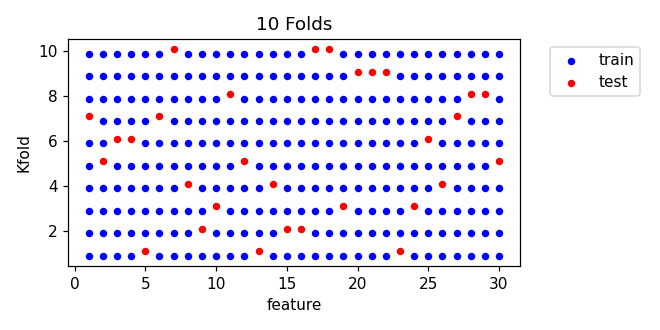

In [133]:
%matplotlib notebook
fig,ax = plt.subplots(1,1, figsize=(6,3))
ax.scatter(x="x",y="val",c="b",label="train",s=15,data=train)
ax.scatter(x="x",y="val",c="r",label="test",s=15,data=test)

ax.set_ylabel("Kfold")
ax.set_xlabel("feature")
ax.set_title("10 Folds")
#plt.suptitle("Kfold split between train and test features")
plt.legend(bbox_to_anchor=(1.05, 1))
plt.tight_layout()
plt.show()

In [106]:
cat_features = []

cv_dataset = Pool(data=train_data,label=y_cad_arr,cat_features=cat_features)

In [107]:
cv_dataset

In [111]:
model = CatBoostRegressor(random_seed=90, od_type='Iter', od_wait=10) #od_type: overfitting detector

In [112]:
model.fit(cv_dataset)

Learning rate set to 0.021031
0:	learn: 8.7838221	total: 64.6ms	remaining: 1m 4s
1:	learn: 8.7301521	total: 66.8ms	remaining: 33.3s
2:	learn: 8.6703124	total: 69.1ms	remaining: 23s
3:	learn: 8.6347150	total: 71.3ms	remaining: 17.8s
4:	learn: 8.5725705	total: 73.5ms	remaining: 14.6s
5:	learn: 8.5384930	total: 75.7ms	remaining: 12.5s
6:	learn: 8.4956705	total: 77.9ms	remaining: 11s
7:	learn: 8.4608788	total: 80.1ms	remaining: 9.93s
8:	learn: 8.4036906	total: 82.2ms	remaining: 9.05s
9:	learn: 8.3492647	total: 84.4ms	remaining: 8.36s
10:	learn: 8.2968303	total: 86.6ms	remaining: 7.79s
11:	learn: 8.2467248	total: 88.8ms	remaining: 7.31s
12:	learn: 8.1788172	total: 90.9ms	remaining: 6.9s
13:	learn: 8.1350312	total: 93.1ms	remaining: 6.56s
14:	learn: 8.1015541	total: 95.4ms	remaining: 6.26s
15:	learn: 8.0398622	total: 97.5ms	remaining: 6s
16:	learn: 7.9856751	total: 99ms	remaining: 5.73s
17:	learn: 7.9445289	total: 101ms	remaining: 5.52s
18:	learn: 7.8954655	total: 103ms	remaining: 5.34s
19:	

181:	learn: 2.9425716	total: 492ms	remaining: 2.21s
182:	learn: 2.9214426	total: 494ms	remaining: 2.21s
183:	learn: 2.9031483	total: 497ms	remaining: 2.2s
184:	learn: 2.8812445	total: 499ms	remaining: 2.2s
185:	learn: 2.8616297	total: 501ms	remaining: 2.19s
186:	learn: 2.8384847	total: 503ms	remaining: 2.19s
187:	learn: 2.8181163	total: 506ms	remaining: 2.19s
188:	learn: 2.7972732	total: 509ms	remaining: 2.18s
189:	learn: 2.7782749	total: 511ms	remaining: 2.18s
190:	learn: 2.7562438	total: 514ms	remaining: 2.18s
191:	learn: 2.7366450	total: 516ms	remaining: 2.17s
192:	learn: 2.7172520	total: 519ms	remaining: 2.17s
193:	learn: 2.6926662	total: 527ms	remaining: 2.19s
194:	learn: 2.6779527	total: 529ms	remaining: 2.19s
195:	learn: 2.6592229	total: 532ms	remaining: 2.18s
196:	learn: 2.6432303	total: 534ms	remaining: 2.18s
197:	learn: 2.6272023	total: 537ms	remaining: 2.17s
198:	learn: 2.6088842	total: 539ms	remaining: 2.17s
199:	learn: 2.5875201	total: 542ms	remaining: 2.17s
200:	learn: 2.

380:	learn: 0.7743705	total: 993ms	remaining: 1.61s
381:	learn: 0.7702176	total: 996ms	remaining: 1.61s
382:	learn: 0.7643405	total: 999ms	remaining: 1.61s
383:	learn: 0.7585187	total: 1s	remaining: 1.61s
384:	learn: 0.7523824	total: 1s	remaining: 1.6s
385:	learn: 0.7484271	total: 1.01s	remaining: 1.6s
386:	learn: 0.7435035	total: 1.01s	remaining: 1.6s
387:	learn: 0.7394954	total: 1.01s	remaining: 1.59s
388:	learn: 0.7335214	total: 1.01s	remaining: 1.59s
389:	learn: 0.7279915	total: 1.02s	remaining: 1.59s
390:	learn: 0.7235524	total: 1.02s	remaining: 1.59s
391:	learn: 0.7197350	total: 1.02s	remaining: 1.58s
392:	learn: 0.7158855	total: 1.02s	remaining: 1.58s
393:	learn: 0.7111875	total: 1.03s	remaining: 1.58s
394:	learn: 0.7068431	total: 1.03s	remaining: 1.58s
395:	learn: 0.7031045	total: 1.03s	remaining: 1.57s
396:	learn: 0.6988255	total: 1.03s	remaining: 1.57s
397:	learn: 0.6945760	total: 1.04s	remaining: 1.57s
398:	learn: 0.6909093	total: 1.04s	remaining: 1.56s
399:	learn: 0.6873010

588:	learn: 0.2385307	total: 1.5s	remaining: 1.04s
589:	learn: 0.2372591	total: 1.5s	remaining: 1.04s
590:	learn: 0.2359785	total: 1.5s	remaining: 1.04s
591:	learn: 0.2347209	total: 1.5s	remaining: 1.04s
592:	learn: 0.2334705	total: 1.51s	remaining: 1.03s
593:	learn: 0.2322109	total: 1.51s	remaining: 1.03s
594:	learn: 0.2309742	total: 1.51s	remaining: 1.03s
595:	learn: 0.2297446	total: 1.52s	remaining: 1.03s
596:	learn: 0.2285220	total: 1.52s	remaining: 1.02s
597:	learn: 0.2272896	total: 1.52s	remaining: 1.02s
598:	learn: 0.2260804	total: 1.52s	remaining: 1.02s
599:	learn: 0.2248781	total: 1.53s	remaining: 1.02s
600:	learn: 0.2236827	total: 1.53s	remaining: 1.01s
601:	learn: 0.2224940	total: 1.53s	remaining: 1.01s
602:	learn: 0.2212946	total: 1.53s	remaining: 1.01s
603:	learn: 0.2198036	total: 1.54s	remaining: 1.01s
604:	learn: 0.2188245	total: 1.54s	remaining: 1s
605:	learn: 0.2176727	total: 1.54s	remaining: 1s
606:	learn: 0.2165160	total: 1.54s	remaining: 1s
607:	learn: 0.2153658	tot

790:	learn: 0.0821942	total: 2s	remaining: 530ms
791:	learn: 0.0817579	total: 2.01s	remaining: 527ms
792:	learn: 0.0813269	total: 2.01s	remaining: 524ms
793:	learn: 0.0808988	total: 2.01s	remaining: 522ms
794:	learn: 0.0804695	total: 2.01s	remaining: 519ms
795:	learn: 0.0800461	total: 2.02s	remaining: 517ms
796:	learn: 0.0796967	total: 2.02s	remaining: 514ms
797:	learn: 0.0792738	total: 2.02s	remaining: 512ms
798:	learn: 0.0788532	total: 2.02s	remaining: 509ms
799:	learn: 0.0784280	total: 2.03s	remaining: 507ms
800:	learn: 0.0780053	total: 2.03s	remaining: 504ms
801:	learn: 0.0775941	total: 2.03s	remaining: 502ms
802:	learn: 0.0771852	total: 2.04s	remaining: 499ms
803:	learn: 0.0767793	total: 2.04s	remaining: 497ms
804:	learn: 0.0763720	total: 2.04s	remaining: 494ms
805:	learn: 0.0760388	total: 2.04s	remaining: 492ms
806:	learn: 0.0756355	total: 2.04s	remaining: 489ms
807:	learn: 0.0752378	total: 2.05s	remaining: 487ms
808:	learn: 0.0748322	total: 2.05s	remaining: 484ms
809:	learn: 0.0

998:	learn: 0.0276977	total: 2.51s	remaining: 2.51ms
999:	learn: 0.0275486	total: 2.51s	remaining: 0us



das ist leider so - 
wenn Sie so stark im n<<p-Regime sind, müssen Sie ihr Modell regularisieren 
(ich würde hier ein l1-regularisiertes lineares Modell empfehlen). 
Dabei kommt es notwendig zu dem von ihnen beschriebenen Auswahlprozess, der auch immer etwas anders ausfällt. 
Sie können schauen, ob es bestimmte Feature gibt, die quasi immer oder zumindest häufig vertreten sind. 
Sie sollten mindestens leave-one-out-Crossvalidation machen, bei dem n<<p-Verhätlnis hat der Trainingerror 
nichts zu sagen.


In [78]:
shap_sum=np.zeros((10))

In [79]:
shap_sum

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [62]:
# data: X input, target: array of labels
def catboost_regressor(data, target, K):
    

    cat_features = []
    

    kf = KFold(n_splits = K, random_state = 1, shuffle = True)
    
    mse_train_sum=[]
    mse_val_sum=[]
    shap_sum=np.zeros((K))
    shap_list=[]
    # set up regressor
    #model = CatBoostRegressor(random_seed=90, od_type='Iter', od_wait=10) #od_type: overfitting detector
    #model = CatBoostRegressor(od_type='IncToDec')
    m=0
    # cross validation
    for i, (train_index, test_index) in enumerate(kf.split(x_cad)):
        
        rand_int = random.randint(0,180)
        
        #model = CatBoostRegressor(random_seed=50,od_type='Iter', od_wait=10) #od_type: overfitting detector
        model = CatBoostRegressor(random_seed=rand_int)
        # Create data for this fold
        y_train, y_valid = target.iloc[train_index], target.iloc[test_index]
        X_train, X_valid = data.iloc[train_index,:], data.iloc[test_index,:]
        print( "\nFold ", i)
        # pool data
        train_data=Pool(data=X_train,
                  label=y_train,
                  cat_features=cat_features)
        test_data=Pool(data=X_valid,
                  label=y_valid,
                  cat_features=cat_features)
        
        
        # Hyperparameter tuning: gridsearch
        grid = {
            "iterations": [40, 60, 100,200],
            "learning_rate": [0.01, 0.05, 0.1, 0.5, 1],
            "depth": [4, 6, 8],
            "l2_leaf_reg": [1, 3, 5, 7, 9]
        }
        grid_result = model.grid_search(grid, X=train_data, cv=10,  
                                        plot=True, verbose=False)
        print('Gridresults: ', grid_result)
    
    
        # Run model for this fold
        # early_stopping_round: overfitting detector
        fit_model = model.fit(train_data,eval_set=test_data, use_best_model=True,early_stopping_rounds=10, plot=True)
        
        # Prediction for train set
        pred_train = fit_model.predict(X_train)
        # MSE for trainset
        mse_t=mean_squared_error(y_train, pred_train)
        
        # Generate validation predictions for this fold
        pred = fit_model.predict(X_valid)
        # MSE for validation set
        mse_v=mean_squared_error(y_valid, pred)
        
        print("MSE train: ", mse_t)
        print("MSE test: ", mse_v)
        
        # append to list for saving mse
        mse_train_sum.append(copy.deepcopy(mse_t))
        mse_val_sum.append(copy.deepcopy(mse_v))
        # calulcating normalized correlation coefficients of the predictions?
        
        #scaler_t = StandardScaler()
        #red_t=scaler_t.fit_transform(pred_train)
        
        #scaler_v = StandardScaler()
        #pred_n=scaler_v.fit_transform(pred)
        
        #print( "  Gini = ", eval_gini(y_valid, pred) )
        #y_valid_pred.iloc[test_index] = pred
        
        print("R squared train: ", model.score(X_train, y_train))
        print("R squared test: ", model.score(X_valid, y_valid))
        print("Random state: ", model.random_seed_)
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X_train)
        shap_sum[m]=copy.deepcopy(shap_values)
        shap_list.append(shap_values)
        #shap_test= explainer.shap_values()
        # print(np.mean(shap_values, axis=1))
        #print(model.get_best_score())
        shap.summary_plot(shap_values, X_train)
        shap.summary_plot(shap_values, X_train, plot_type="bar")
        # Accumulate test set predictions
        #y_test_pred += fit_model.predict_proba(X_data)
        #plot_regression_results(list(range(len(pred_train))), pred_train, y_train, 'target',)
        #plot_regression_results(list(range(len(pred))), pred, y_valid, 'target',)
        m+=1
    #y_test_pred /= K  # Average test set predictions

    #print( "\nGini for full training set:" )
    #eval_gini(y, y_valid_pred)



    # partition_random_seed=42
    #print("Fitting")
    
    
    # return what: median MSE for train & test
    # median shap values:
    
    # calcute the median shap values: 
    calculate_median_shap(shap_list, )
    
    
    
    return mse_train_sum, mse_val_sum, shap_sum
#, shap_values, fi

In [ ]:

def calculate_median_shap(shap_values, samples, features, iterations):
    """
    shap_values: matrix of shap values iteration x samples x features
    samples: int 
    features: int
    iterations: int
    """
    # calculate median over the iterations (these can be the 10folds or 10 iterations - depending)
    # return: matrix samples x features with median values of shap
    # 31 samples, 180 features, 10 shap values
    # final shap matrix for median shap values
    shap_cum=np.zeros((samples,features))
    # loop through samples
    for i in range(samples):
    # loop through features
        for k in range(features):
            shap_arr =np.zeros(iterations)
            for j in range(iterations):
                # bring them all in one array to calculate median along this axis 
                shap_arr[j]=copy.deepcopy(shap_values[j][i][k])
            # calculate median of all shap values    
            shap_median=np.median(shap_arr)
            # save median in cumulated shap value matrix
            shap_cum[i][k]=copy.deepcopy(shap_median)

In [ ]:
#runs K fold CV 10 times and calculates median 
def calculate_regression(data, target, K):
    
    mse_t=[]
    mse_v=[]
    shap_m=[]
    
    for i in range 10:
        # do K fold CV catboost regression with 10 fold cv gridsearch
        mse_train, mse_val, shaps=catboost_regressor(train_data, y_cad['CADSS'], 10)
        
        # calculate median of mse and shap values for the 10 fold CV
        mse_train_median=np.median(np.asarray(mse_train))
        mse_val_median=np.median(np.asarray(mse_val))
        
        shap_median=np.median(np.asarray(shaps))
        
        mse_t.append(copy.deepcopy(mse_train_median))
        mse_v.append(copy.deepcopy(mse_val_median))
        shap_m.append(copy.deepcopy(shap_median))
        
    
    median=
    
    return


Fold  0


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 17.44579154
bestIteration = 39


bestTest = 14.45909443
bestIteration = 38


bestTest = 13.18032928
bestIteration = 39


bestTest = 12.72251981
bestIteration = 25


bestTest = 14.31201196
bestIteration = 0


bestTest = 17.80816023
bestIteration = 39


bestTest = 15.19100944
bestIteration = 38


bestTest = 14.03735963
bestIteration = 39


bestTest = 11.68944386
bestIteration = 39


bestTest = 13.88568009
bestIteration = 39


bestTest = 18.01058581
bestIteration = 39


bestTest = 15.80683089
bestIteration = 39


bestTest = 14.59577221
bestIteration = 39


bestTest = 12.694342
bestIteration = 39


bestTest = 12.8107609
bestIteration = 25


bestTest = 18.16141316
bestIteration = 39


bestTest = 16.0423887
bestIteration = 39


bestTest = 14.84383167
bestIteration = 39


bestTest = 11.94189409
bestIteration = 39


bestTest = 15.14808933
bestIteration = 39


bestTest = 18.27542523
bestIteration = 39


bestTest = 16.46865347
bestIteration = 39


bestTest = 15.34608055
bestIteration


bestTest = 14.41993736
bestIteration = 197


bestTest = 14.92739227
bestIteration = 78


bestTest = 15.09338859
bestIteration = 26


bestTest = 17.00418862
bestIteration = 199


bestTest = 14.6770721
bestIteration = 199


bestTest = 14.05939197
bestIteration = 199


bestTest = 14.10093847
bestIteration = 199


bestTest = 14.59135211
bestIteration = 199


bestTest = 17.33449712
bestIteration = 199


bestTest = 14.91847361
bestIteration = 199


bestTest = 13.8936207
bestIteration = 199


bestTest = 14.21713117
bestIteration = 199


bestTest = 12.56228216
bestIteration = 37


bestTest = 18.10305863
bestIteration = 39


bestTest = 16.75758123
bestIteration = 39


bestTest = 16.15996573
bestIteration = 39


bestTest = 17.59790602
bestIteration = 34


bestTest = 16.09986437
bestIteration = 2


bestTest = 18.11635265
bestIteration = 39


bestTest = 16.65264364
bestIteration = 39


bestTest = 15.38854789
bestIteration = 39


bestTest = 12.53624183
bestIteration = 39


bestTest = 11.89136169
b

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 8.4562040	test: 8.4862209	best: 8.4862209 (0)	total: 1.64ms	remaining: 325ms
1:	learn: 7.6060264	test: 8.1900564	best: 8.1900564 (1)	total: 2.8ms	remaining: 277ms
2:	learn: 6.8170647	test: 8.1199083	best: 8.1199083 (2)	total: 3.95ms	remaining: 260ms
3:	learn: 6.1325668	test: 7.9041697	best: 7.9041697 (3)	total: 5.08ms	remaining: 249ms
4:	learn: 5.6247043	test: 7.7793640	best: 7.7793640 (4)	total: 6.21ms	remaining: 242ms
5:	learn: 5.2087339	test: 7.6767927	best: 7.6767927 (5)	total: 7.56ms	remaining: 245ms
6:	learn: 4.7000673	test: 7.4881491	best: 7.4881491 (6)	total: 9.4ms	remaining: 259ms
7:	learn: 4.3172152	test: 7.5908963	best: 7.4881491 (6)	total: 10.9ms	remaining: 263ms
8:	learn: 3.8486467	test: 7.5799905	best: 7.4881491 (6)	total: 12.3ms	remaining: 262ms
9:	learn: 3.4083742	test: 7.9552143	best: 7.4881491 (6)	total: 13.5ms	remaining: 257ms
10:	learn: 3.0472137	test: 7.7886131	best: 7.4881491 (6)	total: 14.8ms	remaining: 254ms
11:	learn: 2.7080844	test: 7.5688289	best: 7

Setting feature_perturbation = "tree_path_dependent" because no background data was given.


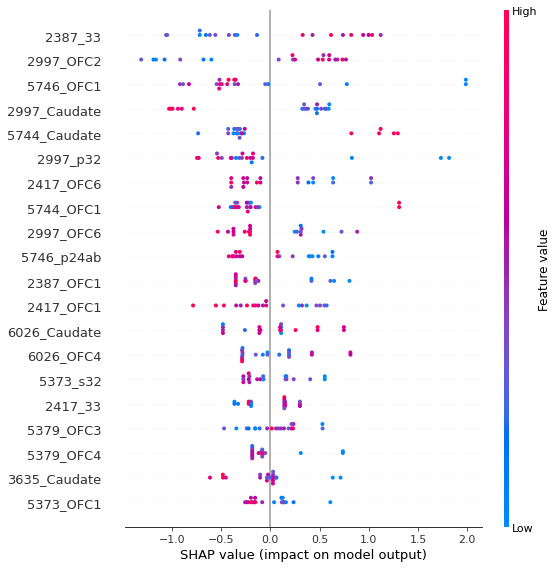

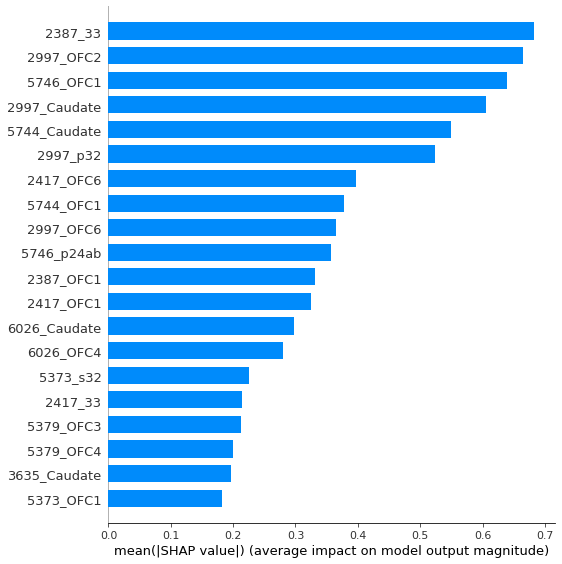


Fold  1


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 15.93826031
bestIteration = 39


bestTest = 14.09437972
bestIteration = 39


bestTest = 13.1872804
bestIteration = 37


bestTest = 14.83683856
bestIteration = 5


bestTest = 16.00682956
bestIteration = 2


bestTest = 16.22413932
bestIteration = 39


bestTest = 14.58256952
bestIteration = 39


bestTest = 13.29711285
bestIteration = 37


bestTest = 13.8231033
bestIteration = 12


bestTest = 15.34006562
bestIteration = 4


bestTest = 16.40665011
bestIteration = 39


bestTest = 14.86911574
bestIteration = 39


bestTest = 14.10527375
bestIteration = 39


bestTest = 14.20926161
bestIteration = 16


bestTest = 14.87601096
bestIteration = 39


bestTest = 16.52806118
bestIteration = 39


bestTest = 15.12796111
bestIteration = 39


bestTest = 14.44712498
bestIteration = 39


bestTest = 13.70028956
bestIteration = 24


bestTest = 14.89085219
bestIteration = 4


bestTest = 16.59155787
bestIteration = 39


bestTest = 15.50055085
bestIteration = 39


bestTest = 14.72299119
bestIteration 


bestTest = 13.93946871
bestIteration = 198


bestTest = 15.1542564
bestIteration = 199


bestTest = 15.77428843
bestIteration = 197


bestTest = 15.83838161
bestIteration = 198


bestTest = 14.23451187
bestIteration = 199


bestTest = 14.0869644
bestIteration = 199


bestTest = 14.38379003
bestIteration = 199


bestTest = 13.89429355
bestIteration = 199


bestTest = 16.05836298
bestIteration = 199


bestTest = 14.2689863
bestIteration = 199


bestTest = 13.78189464
bestIteration = 199


bestTest = 14.05531851
bestIteration = 199


bestTest = 12.63201877
bestIteration = 199


bestTest = 16.29183946
bestIteration = 39


bestTest = 15.00496662
bestIteration = 39


bestTest = 14.51221919
bestIteration = 35


bestTest = 15.22009573
bestIteration = 39


bestTest = 15.49928057
bestIteration = 6


bestTest = 16.41785461
bestIteration = 39


bestTest = 15.10291681
bestIteration = 39


bestTest = 15.18742491
bestIteration = 38


bestTest = 13.61964535
bestIteration = 39


bestTest = 13.78761002

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 8.7377891	test: 8.8999397	best: 8.8999397 (0)	total: 1.6ms	remaining: 318ms
1:	learn: 8.6436812	test: 8.8877695	best: 8.8877695 (1)	total: 2.85ms	remaining: 282ms
2:	learn: 8.5350272	test: 8.8764961	best: 8.8764961 (2)	total: 4.02ms	remaining: 264ms
3:	learn: 8.4697868	test: 8.8779630	best: 8.8764961 (2)	total: 5.2ms	remaining: 255ms
4:	learn: 8.3342088	test: 8.8709953	best: 8.8709953 (4)	total: 6.7ms	remaining: 261ms
5:	learn: 8.1732962	test: 8.9219385	best: 8.8709953 (4)	total: 7.91ms	remaining: 256ms
6:	learn: 8.0519218	test: 8.8171162	best: 8.8171162 (6)	total: 9.48ms	remaining: 262ms
7:	learn: 7.9302250	test: 8.8995092	best: 8.8171162 (6)	total: 11.5ms	remaining: 275ms
8:	learn: 7.7404185	test: 8.9744224	best: 8.8171162 (6)	total: 12.8ms	remaining: 272ms
9:	learn: 7.6379898	test: 8.8801422	best: 8.8171162 (6)	total: 14.8ms	remaining: 282ms
10:	learn: 7.5313569	test: 8.8807497	best: 8.8171162 (6)	total: 16.2ms	remaining: 278ms
11:	learn: 7.4023204	test: 8.8418154	best: 8.

Setting feature_perturbation = "tree_path_dependent" because no background data was given.


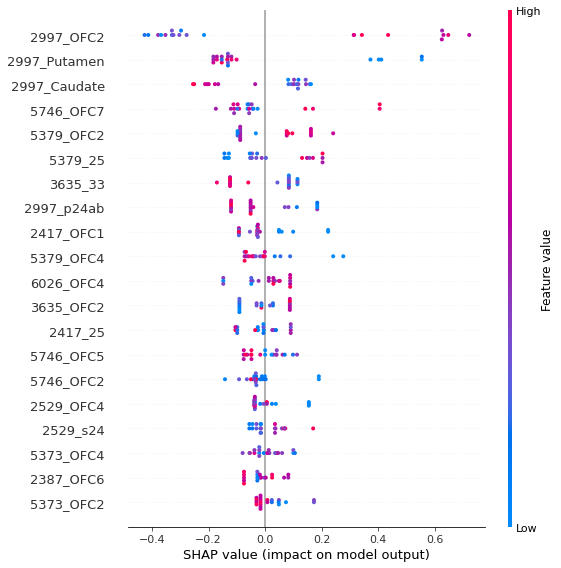

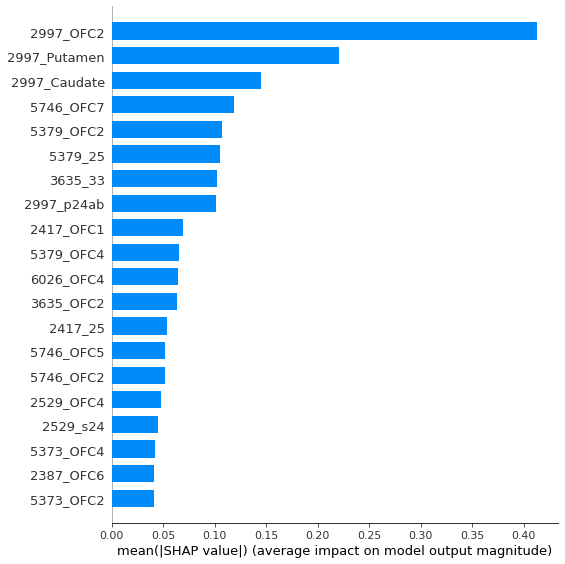


Fold  2


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 17.60892831
bestIteration = 39


bestTest = 15.55006535
bestIteration = 38


bestTest = 14.48413863
bestIteration = 39


bestTest = 13.36784819
bestIteration = 3


bestTest = 12.27096723
bestIteration = 3


bestTest = 17.95113164
bestIteration = 39


bestTest = 16.18881438
bestIteration = 38


bestTest = 15.3826821
bestIteration = 39


bestTest = 12.87240545
bestIteration = 26


bestTest = 12.32566468
bestIteration = 16


bestTest = 18.10695155
bestIteration = 39


bestTest = 16.81636941
bestIteration = 39


bestTest = 15.81109263
bestIteration = 39


bestTest = 13.95941243
bestIteration = 39


bestTest = 14.02351349
bestIteration = 5


bestTest = 18.21121336
bestIteration = 39


bestTest = 17.02838204
bestIteration = 39


bestTest = 16.26145897
bestIteration = 39


bestTest = 12.88518494
bestIteration = 39


bestTest = 13.36399706
bestIteration = 39


bestTest = 18.28023026
bestIteration = 39


bestTest = 17.21043419
bestIteration = 39


bestTest = 16.3295187
bestIteration


bestTest = 14.31744076
bestIteration = 199


bestTest = 11.98909669
bestIteration = 108


bestTest = 12.03878852
bestIteration = 197


bestTest = 17.36769855
bestIteration = 199


bestTest = 14.89356946
bestIteration = 199


bestTest = 14.20067498
bestIteration = 197


bestTest = 11.96283115
bestIteration = 199


bestTest = 13.2861361
bestIteration = 75


bestTest = 17.59980419
bestIteration = 199


bestTest = 14.98900387
bestIteration = 199


bestTest = 14.38148651
bestIteration = 199


bestTest = 12.70804564
bestIteration = 199


bestTest = 13.20160814
bestIteration = 199


bestTest = 17.81268189
bestIteration = 39


bestTest = 16.28002985
bestIteration = 38


bestTest = 15.4702424
bestIteration = 37


bestTest = 14.17450957
bestIteration = 39


bestTest = 13.59857728
bestIteration = 1


bestTest = 18.12568909
bestIteration = 39


bestTest = 16.88729222
bestIteration = 39


bestTest = 15.45230146
bestIteration = 39


bestTest = 12.6860772
bestIteration = 39


bestTest = 12.43538501


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 7.5645047	test: 9.9501093	best: 9.9501093 (0)	total: 2.92ms	remaining: 581ms
1:	learn: 6.9023405	test: 9.9897869	best: 9.9501093 (0)	total: 5.21ms	remaining: 516ms
2:	learn: 6.4577524	test: 9.8073273	best: 9.8073273 (2)	total: 7.72ms	remaining: 507ms
3:	learn: 6.0118864	test: 9.8183002	best: 9.8073273 (2)	total: 10.7ms	remaining: 523ms
4:	learn: 5.5384846	test: 9.5937834	best: 9.5937834 (4)	total: 14.9ms	remaining: 582ms
5:	learn: 4.9176476	test: 9.1995856	best: 9.1995856 (5)	total: 17.4ms	remaining: 563ms
6:	learn: 4.4581742	test: 8.7935305	best: 8.7935305 (6)	total: 19.4ms	remaining: 534ms
7:	learn: 4.1616014	test: 8.7389784	best: 8.7389784 (7)	total: 21.7ms	remaining: 521ms
8:	learn: 3.8802497	test: 8.6309397	best: 8.6309397 (8)	total: 23.6ms	remaining: 500ms
9:	learn: 3.6335511	test: 8.5572239	best: 8.5572239 (9)	total: 25.4ms	remaining: 482ms
10:	learn: 3.3885216	test: 8.4905643	best: 8.4905643 (10)	total: 27.2ms	remaining: 468ms
11:	learn: 3.1764365	test: 8.4547026	best

153:	learn: 0.0003324	test: 7.8310761	best: 7.8310761 (153)	total: 308ms	remaining: 91.9ms
154:	learn: 0.0003117	test: 7.8310733	best: 7.8310733 (154)	total: 310ms	remaining: 89.9ms
155:	learn: 0.0002922	test: 7.8310708	best: 7.8310708 (155)	total: 312ms	remaining: 87.9ms
156:	learn: 0.0002739	test: 7.8310684	best: 7.8310684 (156)	total: 313ms	remaining: 85.8ms
157:	learn: 0.0002568	test: 7.8310661	best: 7.8310661 (157)	total: 315ms	remaining: 83.8ms
158:	learn: 0.0002407	test: 7.8310640	best: 7.8310640 (158)	total: 317ms	remaining: 81.8ms
159:	learn: 0.0002257	test: 7.8310620	best: 7.8310620 (159)	total: 320ms	remaining: 80ms
160:	learn: 0.0002116	test: 7.8310602	best: 7.8310602 (160)	total: 322ms	remaining: 78ms
161:	learn: 0.0001984	test: 7.8310585	best: 7.8310585 (161)	total: 324ms	remaining: 76ms
162:	learn: 0.0001860	test: 7.8310568	best: 7.8310568 (162)	total: 326ms	remaining: 73.9ms
163:	learn: 0.0001743	test: 7.8310553	best: 7.8310553 (163)	total: 328ms	remaining: 71.9ms
164:	

Setting feature_perturbation = "tree_path_dependent" because no background data was given.


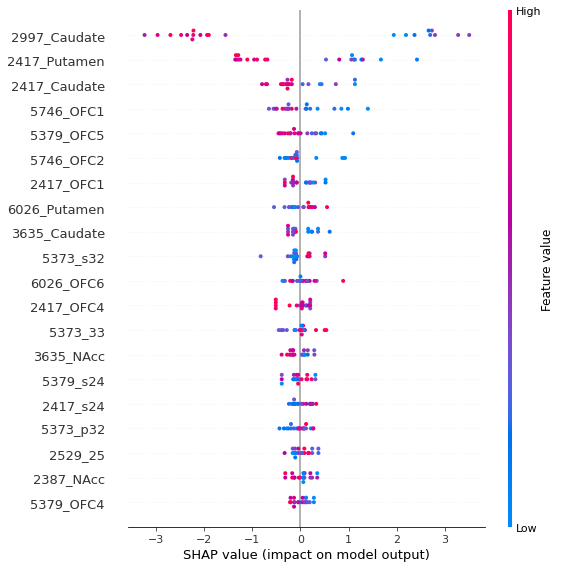

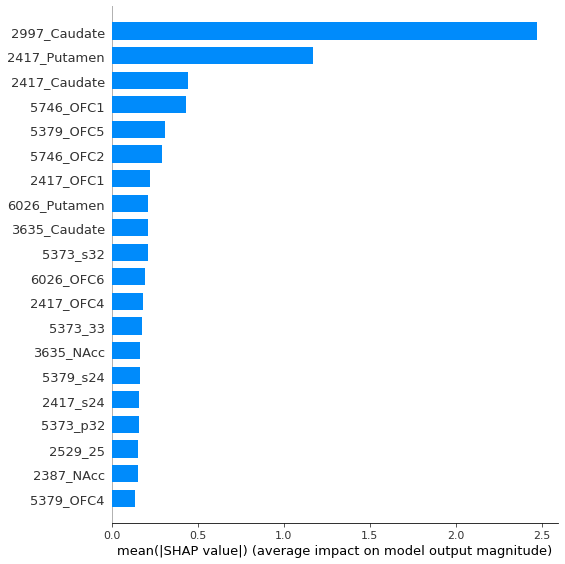

In [64]:
mse_train_sum, mse_val_sum, shap_sum=catboost_regressor(train_data, y_cad['CADSS'], 3)

In [75]:
len(shap_sum[2])

21

In [71]:
shap_sum[0]

array([[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  3.27462981e-02,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  3.18790570e-03,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00, -1.31844567e-02,  0.00000000e+00],
       ...,
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  5.08046730e-05,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00, -6.68256138e-02,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  1.73067991e-01,  0.00000000e+00]])


Fold  0


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 6.646884492
bestIteration = 19


bestTest = 5.056076063
bestIteration = 17


bestTest = 4.364789006
bestIteration = 16


bestTest = 3.993022535
bestIteration = 14

Stopped by overfitting detector  (10 iterations wait)

bestTest = 4.688441264
bestIteration = 0


bestTest = 6.956026266
bestIteration = 19


bestTest = 5.331068367
bestIteration = 19


bestTest = 4.546655471
bestIteration = 18


bestTest = 3.997771196
bestIteration = 11

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.409558905
bestIteration = 1


bestTest = 7.120155792
bestIteration = 19


bestTest = 5.743478671
bestIteration = 19


bestTest = 4.785244925
bestIteration = 19


bestTest = 3.281181576
bestIteration = 11


bestTest = 4.940657307
bestIteration = 18


bestTest = 7.229752012
bestIteration = 19


bestTest = 6.120160727
bestIteration = 19


bestTest = 5.130372667
bestIteration = 18


bestTest = 3.16254964
bestIteration = 19


bestTest = 4.590126438
bestIteration = 19


bestTest = 7.2


bestTest = 5.668861758
bestIteration = 24


bestTest = 5.039670861
bestIteration = 32

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.686187365
bestIteration = 2

Stopped by overfitting detector  (10 iterations wait)

bestTest = 4.709255072
bestIteration = 0


bestTest = 6.919401405
bestIteration = 39


bestTest = 5.562130951
bestIteration = 38


bestTest = 4.718370931
bestIteration = 37


bestTest = 5.36707979
bestIteration = 39

Stopped by overfitting detector  (10 iterations wait)

bestTest = 7.500694412
bestIteration = 0


bestTest = 6.996531953
bestIteration = 39


bestTest = 5.688224159
bestIteration = 39


bestTest = 4.695831898
bestIteration = 39


bestTest = 3.940139337
bestIteration = 39

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.164993801
bestIteration = 6


bestTest = 7.103874838
bestIteration = 39


bestTest = 5.886492681
bestIteration = 39


bestTest = 4.932748081
bestIteration = 37

Stopped by overfitting detector  (10 iter


bestTest = 5.088907199
bestIteration = 59


bestTest = 2.045868382
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.748521318
bestIteration = 12


bestTest = 7.143972418
bestIteration = 59


bestTest = 6.04423098
bestIteration = 59


bestTest = 5.224855953
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 1.67311717
bestIteration = 44


bestTest = 4.683936077
bestIteration = 59


bestTest = 6.139185757
bestIteration = 99

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.214957506
bestIteration = 68

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.66131983
bestIteration = 27


bestTest = 4.93672369
bestIteration = 99

Stopped by overfitting detector  (10 iterations wait)

bestTest = 4.456253597
bestIteration = 5


bestTest = 6.311363331
bestIteration = 99


bestTest = 4.815134835
bestIteration = 99


bestTest = 4.777667833
bestIteration = 97


bestTest = 5.261879806
bestIte

32:	learn: 1.4088895	total: 165ms	remaining: 135ms
33:	learn: 1.3384450	total: 171ms	remaining: 131ms
34:	learn: 1.2715228	total: 178ms	remaining: 127ms
35:	learn: 1.2079467	total: 182ms	remaining: 121ms
36:	learn: 1.1475493	total: 188ms	remaining: 117ms
37:	learn: 1.0901719	total: 195ms	remaining: 113ms
38:	learn: 1.0356633	total: 199ms	remaining: 107ms
39:	learn: 0.9838801	total: 205ms	remaining: 102ms
40:	learn: 0.9346861	total: 210ms	remaining: 97.5ms
41:	learn: 0.8879518	total: 216ms	remaining: 92.6ms
42:	learn: 0.8435542	total: 222ms	remaining: 87.6ms
43:	learn: 0.8013765	total: 227ms	remaining: 82.7ms
44:	learn: 0.7613077	total: 233ms	remaining: 77.7ms
45:	learn: 0.7232423	total: 239ms	remaining: 72.7ms
46:	learn: 0.6870802	total: 244ms	remaining: 67.6ms
47:	learn: 0.6527262	total: 248ms	remaining: 61.9ms
48:	learn: 0.6200899	total: 253ms	remaining: 56.9ms
49:	learn: 0.5890854	total: 259ms	remaining: 51.8ms
50:	learn: 0.5596311	total: 265ms	remaining: 46.7ms
51:	learn: 0.5316495

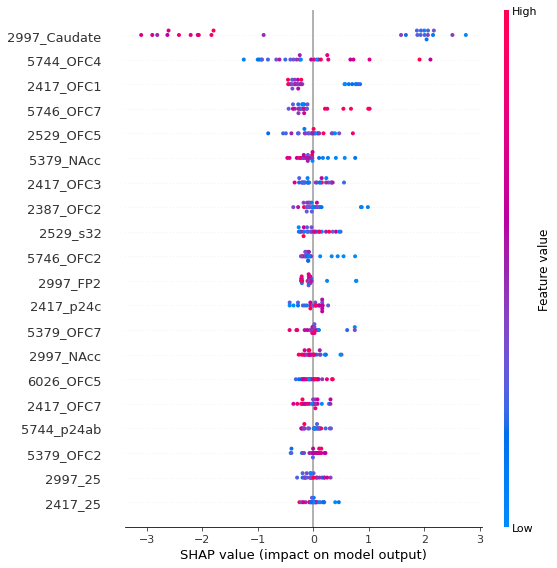

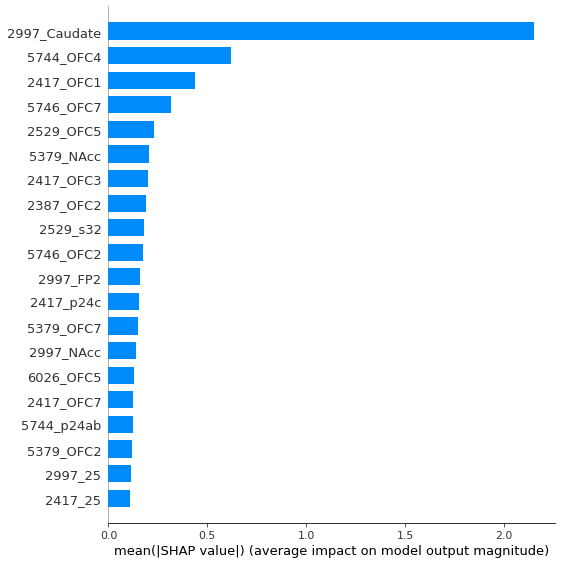


Fold  1


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 15.20498685
bestIteration = 19


bestTest = 13.41036342
bestIteration = 19


bestTest = 12.89784122
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.06411654
bestIteration = 5

Stopped by overfitting detector  (10 iterations wait)

bestTest = 9.970975218
bestIteration = 2


bestTest = 15.47183806
bestIteration = 19


bestTest = 14.08739228
bestIteration = 19


bestTest = 13.25739995
bestIteration = 19


bestTest = 11.6410546
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.35364558
bestIteration = 5


bestTest = 15.57535477
bestIteration = 19


bestTest = 14.24973961
bestIteration = 19


bestTest = 13.32554894
bestIteration = 19


bestTest = 12.48774966
bestIteration = 16


bestTest = 11.169699
bestIteration = 19


bestTest = 15.6008503
bestIteration = 19


bestTest = 14.51436171
bestIteration = 19


bestTest = 13.58212254
bestIteration = 19


bestTest = 12.00875523
bestIteration = 19


bestTest


bestTest = 12.43159233
bestIteration = 58


bestTest = 12.4719098
bestIteration = 59


bestTest = 13.77642621
bestIteration = 59


bestTest = 15.14357836
bestIteration = 59


bestTest = 14.10372415
bestIteration = 59


bestTest = 13.03855409
bestIteration = 59


bestTest = 12.86596361
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.72138824
bestIteration = 39


bestTest = 15.21867142
bestIteration = 59


bestTest = 14.15608482
bestIteration = 59


bestTest = 13.13314795
bestIteration = 58


bestTest = 12.48329781
bestIteration = 59


bestTest = 10.52103379
bestIteration = 59


bestTest = 15.31289932
bestIteration = 59


bestTest = 13.84291997
bestIteration = 59


bestTest = 13.42268889
bestIteration = 59


bestTest = 11.56080619
bestIteration = 59


bestTest = 11.18037004
bestIteration = 59


bestTest = 13.48066871
bestIteration = 99

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.19919349
bestIteration = 58


bestTest = 1

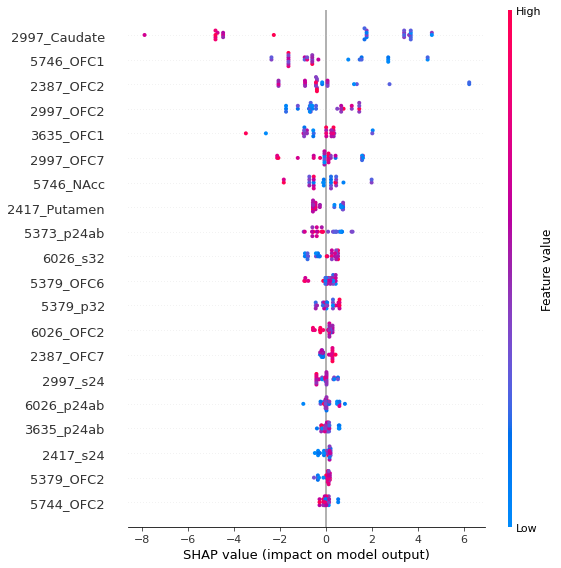

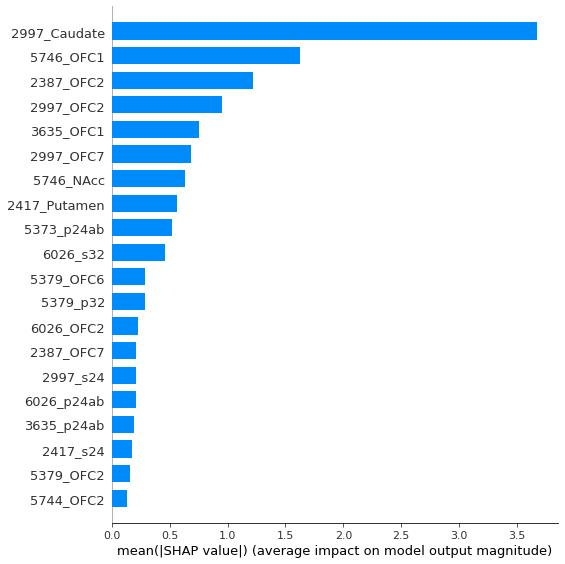


Fold  2


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 14.01566084
bestIteration = 19


bestTest = 12.75352487
bestIteration = 18

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.93412813
bestIteration = 6


bestTest = 11.37315563
bestIteration = 10

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.12475573
bestIteration = 1


bestTest = 14.15057737
bestIteration = 19


bestTest = 13.16790321
bestIteration = 18


bestTest = 12.63075555
bestIteration = 18

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.3431295
bestIteration = 4

Stopped by overfitting detector  (10 iterations wait)

bestTest = 10.82006083
bestIteration = 7


bestTest = 14.27912234
bestIteration = 19


bestTest = 13.42551292
bestIteration = 18


bestTest = 12.64541273
bestIteration = 18


bestTest = 10.32242456
bestIteration = 19


bestTest = 10.61656979
bestIteration = 19


bestTest = 14.33357033
bestIteration = 19


bestTest = 13.57974766
bestIteration = 19


bestTest = 12.98744656
bestIteration = 1

bestTest = 12.72308399
bestIteration = 39

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.16601692
bestIteration = 7

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.71325597
bestIteration = 11


bestTest = 14.09950759
bestIteration = 39


bestTest = 12.99817373
bestIteration = 38


bestTest = 12.57698898
bestIteration = 35


bestTest = 12.13312017
bestIteration = 38


bestTest = 12.60828054
bestIteration = 39


bestTest = 14.11724587
bestIteration = 39


bestTest = 12.96970912
bestIteration = 39


bestTest = 12.59600852
bestIteration = 34


bestTest = 12.96137046
bestIteration = 39


bestTest = 12.67165835
bestIteration = 39


bestTest = 14.19726318
bestIteration = 39


bestTest = 13.14902606
bestIteration = 39


bestTest = 12.49409772
bestIteration = 34


bestTest = 11.98855042
bestIteration = 39


bestTest = 11.58549075
bestIteration = 39


bestTest = 14.24730726
bestIteration = 39


bestTest = 13.219616
bestIteration = 39


bestTest = 12.5


bestTest = 12.70169323
bestIteration = 37


bestTest = 14.14883901
bestIteration = 99


bestTest = 13.01164035
bestIteration = 99


bestTest = 12.3326553
bestIteration = 99


bestTest = 11.85307696
bestIteration = 99


bestTest = 10.49724696
bestIteration = 99


bestTest = 14.09255427
bestIteration = 99


bestTest = 13.25636476
bestIteration = 99


bestTest = 12.50150098
bestIteration = 99


bestTest = 11.34232941
bestIteration = 99


bestTest = 9.471255053
bestIteration = 99

Gridresults:  {'params': {'depth': 8, 'learning_rate': 1, 'l2_leaf_reg': 9, 'iterations': 100}, 'cv_results': defaultdict(<class 'list'>, {'iterations': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 9

41:	learn: 0.0954233	total: 157ms	remaining: 217ms
42:	learn: 0.0858810	total: 161ms	remaining: 213ms
43:	learn: 0.0772929	total: 166ms	remaining: 211ms
44:	learn: 0.0695636	total: 170ms	remaining: 207ms
45:	learn: 0.0626072	total: 174ms	remaining: 204ms
46:	learn: 0.0563465	total: 177ms	remaining: 200ms
47:	learn: 0.0507119	total: 181ms	remaining: 196ms
48:	learn: 0.0456407	total: 186ms	remaining: 193ms
49:	learn: 0.0410766	total: 190ms	remaining: 190ms
50:	learn: 0.0369689	total: 194ms	remaining: 186ms
51:	learn: 0.0332720	total: 198ms	remaining: 182ms
52:	learn: 0.0299448	total: 201ms	remaining: 178ms
53:	learn: 0.0269504	total: 204ms	remaining: 174ms
54:	learn: 0.0242553	total: 208ms	remaining: 170ms
55:	learn: 0.0218298	total: 211ms	remaining: 166ms
56:	learn: 0.0196468	total: 214ms	remaining: 162ms
57:	learn: 0.0176821	total: 218ms	remaining: 158ms
58:	learn: 0.0159139	total: 221ms	remaining: 153ms
59:	learn: 0.0143225	total: 224ms	remaining: 149ms
60:	learn: 0.0128903	total: 227

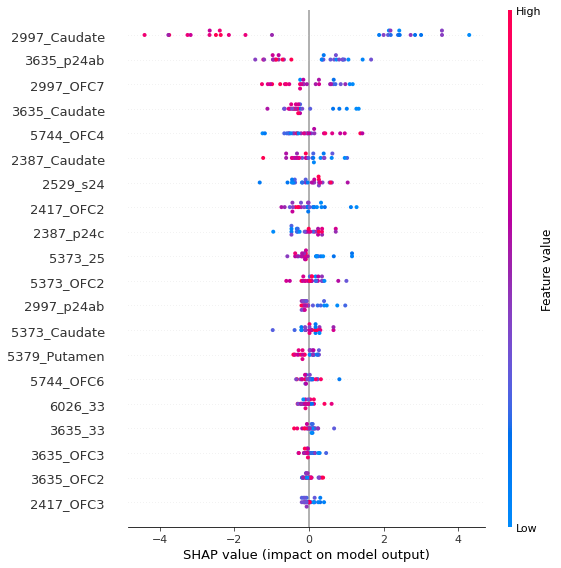

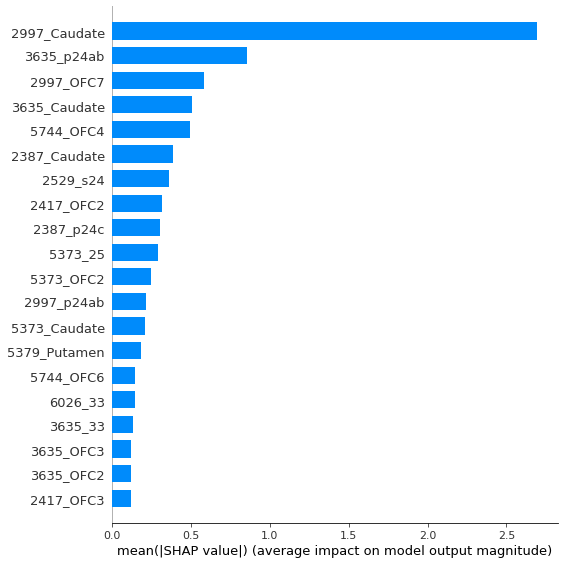


Fold  3


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 14.3553702
bestIteration = 19


bestTest = 13.20351097
bestIteration = 19


bestTest = 12.92245734
bestIteration = 15

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.17647955
bestIteration = 1

Stopped by overfitting detector  (10 iterations wait)

bestTest = 10.00786728
bestIteration = 0


bestTest = 14.49878741
bestIteration = 19


bestTest = 13.49582566
bestIteration = 19


bestTest = 13.26810064
bestIteration = 19


bestTest = 11.44884189
bestIteration = 16

Stopped by overfitting detector  (10 iterations wait)

bestTest = 10.15411334
bestIteration = 5


bestTest = 14.56564781
bestIteration = 19


bestTest = 13.76913114
bestIteration = 19


bestTest = 13.35087492
bestIteration = 19


bestTest = 11.44645463
bestIteration = 13


bestTest = 10.5981668
bestIteration = 18


bestTest = 14.58953042
bestIteration = 19


bestTest = 13.79364329
bestIteration = 19


bestTest = 13.23820643
bestIteration = 19


bestTest = 10.63863575
bestIteration = 17


bestTe

bestTest = 14.48344734
bestIteration = 39


bestTest = 13.3477227
bestIteration = 39


bestTest = 12.73691263
bestIteration = 39


bestTest = 11.03949939
bestIteration = 38


bestTest = 10.91804794
bestIteration = 39


bestTest = 14.52516369
bestIteration = 39


bestTest = 13.45066184
bestIteration = 39


bestTest = 12.8803282
bestIteration = 39


bestTest = 11.22839199
bestIteration = 39


bestTest = 11.80313087
bestIteration = 39


bestTest = 13.52952226
bestIteration = 59


bestTest = 11.67428118
bestIteration = 55


bestTest = 10.73460542
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.48706392
bestIteration = 5

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.41665192
bestIteration = 3


bestTest = 14.08349623
bestIteration = 59


bestTest = 12.71150969
bestIteration = 54


bestTest = 11.46843639
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.94337393
bestIteration = 28


bestTe

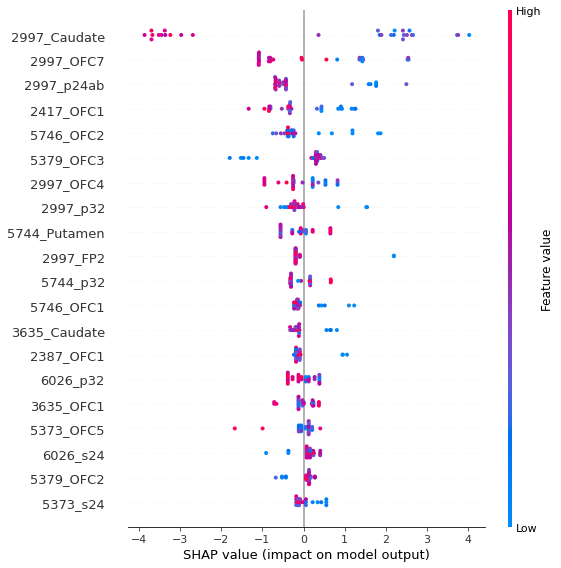

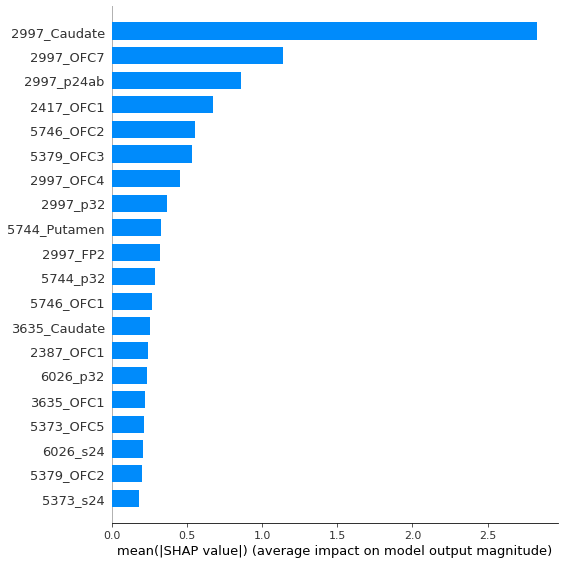


Fold  4


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 15.0336862
bestIteration = 19


bestTest = 12.99043056
bestIteration = 19


bestTest = 12.75136604
bestIteration = 19


bestTest = 12.4156439
bestIteration = 10

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.35348577
bestIteration = 2


bestTest = 15.27023394
bestIteration = 19


bestTest = 13.85887139
bestIteration = 19


bestTest = 12.99757133
bestIteration = 17


bestTest = 12.13941704
bestIteration = 19


bestTest = 10.64906098
bestIteration = 11


bestTest = 15.35060528
bestIteration = 19


bestTest = 14.09998083
bestIteration = 19


bestTest = 13.1037846
bestIteration = 19


bestTest = 12.16191202
bestIteration = 14


bestTest = 12.38184508
bestIteration = 11


bestTest = 15.43586868
bestIteration = 19


bestTest = 14.39306319
bestIteration = 19


bestTest = 13.41362211
bestIteration = 19


bestTest = 11.95415858
bestIteration = 18


bestTest = 14.16250202
bestIteration = 14


bestTest = 15.47088982
bestIteration = 19


bestTest = 14.74291655
be


bestTest = 13.5403738
bestIteration = 39


bestTest = 11.86042092
bestIteration = 39


bestTest = 13.89403779
bestIteration = 39


bestTest = 15.40083042
bestIteration = 39


bestTest = 14.40344209
bestIteration = 39


bestTest = 13.49480944
bestIteration = 39


bestTest = 11.95992854
bestIteration = 39


bestTest = 12.29039068
bestIteration = 39


bestTest = 14.68233612
bestIteration = 59


bestTest = 13.39667619
bestIteration = 53


bestTest = 12.66546397
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.12370124
bestIteration = 4

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.8562557
bestIteration = 0


bestTest = 14.96845149
bestIteration = 59


bestTest = 13.7623886
bestIteration = 56


bestTest = 12.91928288
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.03042288
bestIteration = 14

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.34666499
bestIteration = 5


bestTest = 10.78987844
bestIteration = 99

Gridresults:  {'params': {'depth': 6, 'l2_leaf_reg': 5, 'iterations': 100, 'learning_rate': 0.5}, 'cv_results': defaultdict(<class 'list'>, {'iterations': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99], 'test-RMSE-mean': [11.8417059159467, 11.219642216682168, 10.942297035407147, 10.603008839577708, 10.14625231601306, 10.03040074364117, 9.970907268883197, 9.782244309672228, 9.6145947342421, 9.487899350866773, 9.279215887455118, 9.154694632177675, 9.089266414536798, 9.00407226440404, 8.846434425032992, 8.726453602421802, 8.670547519807576, 8.647693357817547, 8.61654431134665, 8.577727549725362, 8.5380017966

74:	learn: 0.0086150	total: 157ms	remaining: 52.2ms
75:	learn: 0.0078974	total: 159ms	remaining: 50.2ms
76:	learn: 0.0072423	total: 161ms	remaining: 48.1ms
77:	learn: 0.0066354	total: 163ms	remaining: 46ms
78:	learn: 0.0060852	total: 165ms	remaining: 43.9ms
79:	learn: 0.0055817	total: 168ms	remaining: 41.9ms
80:	learn: 0.0051146	total: 170ms	remaining: 39.8ms
81:	learn: 0.0046867	total: 172ms	remaining: 37.7ms
82:	learn: 0.0042956	total: 174ms	remaining: 35.6ms
83:	learn: 0.0039395	total: 176ms	remaining: 33.5ms
84:	learn: 0.0036100	total: 178ms	remaining: 31.4ms
85:	learn: 0.0033108	total: 180ms	remaining: 29.3ms
86:	learn: 0.0030347	total: 182ms	remaining: 27.2ms
87:	learn: 0.0027834	total: 184ms	remaining: 25.1ms
88:	learn: 0.0025504	total: 186ms	remaining: 23ms
89:	learn: 0.0023372	total: 188ms	remaining: 20.9ms
90:	learn: 0.0021435	total: 190ms	remaining: 18.8ms
91:	learn: 0.0019645	total: 192ms	remaining: 16.7ms
92:	learn: 0.0018017	total: 194ms	remaining: 14.6ms
93:	learn: 0.001

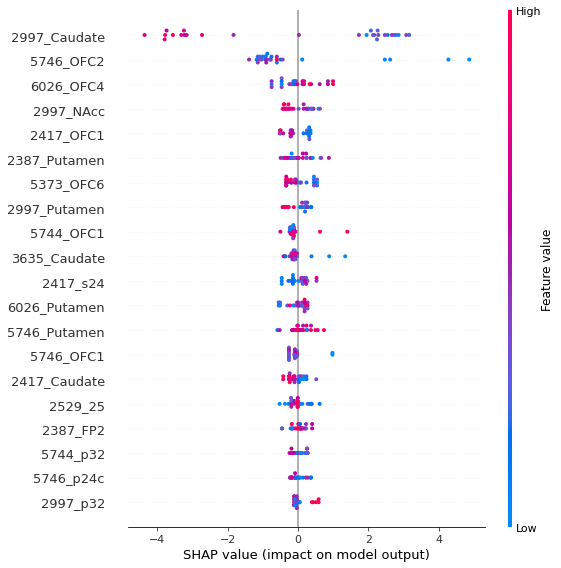

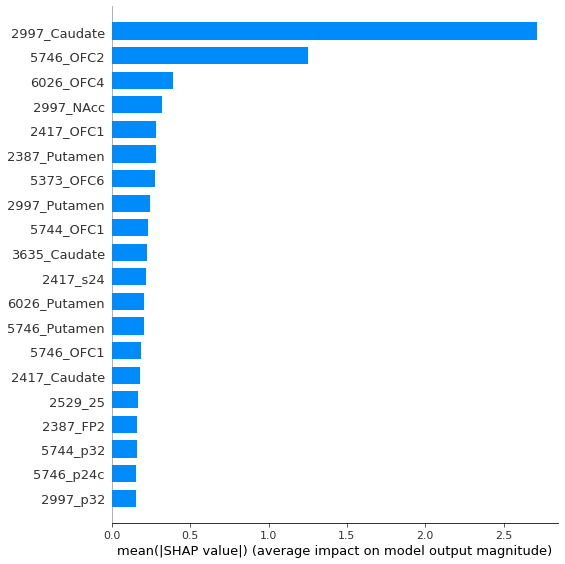


Fold  5


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 15.72387719
bestIteration = 19


bestTest = 14.00139871
bestIteration = 19


bestTest = 12.87985981
bestIteration = 19


bestTest = 12.43328203
bestIteration = 16

Stopped by overfitting detector  (10 iterations wait)

bestTest = 15.03443292
bestIteration = 2


bestTest = 15.93338735
bestIteration = 19


bestTest = 14.50748989
bestIteration = 19


bestTest = 13.27230126
bestIteration = 19


bestTest = 13.07060159
bestIteration = 18


bestTest = 13.05777319
bestIteration = 12


bestTest = 16.02367966
bestIteration = 19


bestTest = 14.82542398
bestIteration = 19


bestTest = 13.7829803
bestIteration = 19


bestTest = 11.38716575
bestIteration = 19


bestTest = 13.15422565
bestIteration = 19


bestTest = 16.08074427
bestIteration = 19


bestTest = 15.01670412
bestIteration = 19


bestTest = 14.14608786
bestIteration = 19


bestTest = 11.8813117
bestIteration = 19


bestTest = 11.73086671
bestIteration = 19


bestTest = 16.13201778
bestIteration = 19


bestTest = 15.17259533
b


bestTest = 12.64630231
bestIteration = 59


bestTest = 14.03808796
bestIteration = 59


bestTest = 16.01443658
bestIteration = 59


bestTest = 14.79352219
bestIteration = 59


bestTest = 13.8997752
bestIteration = 59


bestTest = 13.48504529
bestIteration = 59


bestTest = 15.3328506
bestIteration = 59


bestTest = 16.03836625
bestIteration = 59


bestTest = 14.91318761
bestIteration = 59


bestTest = 14.43323491
bestIteration = 59


bestTest = 11.57188848
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.82626487
bestIteration = 38


bestTest = 14.67485124
bestIteration = 99


bestTest = 12.69784335
bestIteration = 99


bestTest = 12.15200425
bestIteration = 99


bestTest = 13.5360585
bestIteration = 99

Stopped by overfitting detector  (10 iterations wait)

bestTest = 16.4532165
bestIteration = 0


bestTest = 15.28714402
bestIteration = 98


bestTest = 13.48198992
bestIteration = 99


bestTest = 12.98038474
bestIteration = 99


bestTest = 13.84

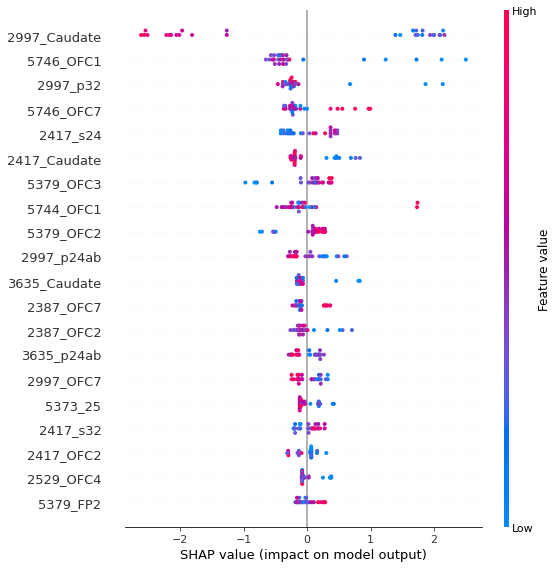

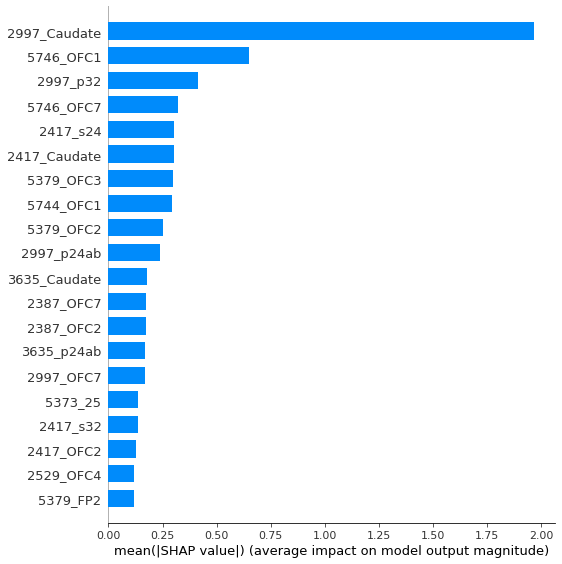


Fold  6


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 15.08581142
bestIteration = 19


bestTest = 13.38611657
bestIteration = 19


bestTest = 12.65333637
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.37386309
bestIteration = 6

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.54594297
bestIteration = 3


bestTest = 15.23872461
bestIteration = 19


bestTest = 13.78506751
bestIteration = 19


bestTest = 12.89589709
bestIteration = 19


bestTest = 11.05705199
bestIteration = 11

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.25927145
bestIteration = 2


bestTest = 15.36746638
bestIteration = 19


bestTest = 14.14274321
bestIteration = 19


bestTest = 13.38157755
bestIteration = 19


bestTest = 10.19452132
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 10.52523069
bestIteration = 8


bestTest = 15.44641329
bestIteration = 19


bestTest = 14.50979827
bestIteration = 19


bestTest = 13.79731091
bestIteration = 

bestTest = 14.71769296
bestIteration = 38


bestTest = 14.18310135
bestIteration = 35


bestTest = 12.41583848
bestIteration = 39

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.23514444
bestIteration = 8


bestTest = 15.49481103
bestIteration = 39


bestTest = 14.6077069
bestIteration = 39


bestTest = 14.43599536
bestIteration = 38


bestTest = 12.87105442
bestIteration = 39


bestTest = 11.54473993
bestIteration = 39


bestTest = 14.64980057
bestIteration = 59


bestTest = 13.12294462
bestIteration = 59


bestTest = 12.68065168
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.61544922
bestIteration = 23

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.83054849
bestIteration = 2


bestTest = 15.0816998
bestIteration = 59


bestTest = 13.80971238
bestIteration = 58


bestTest = 13.00858001
bestIteration = 59


bestTest = 12.12365892
bestIteration = 59


bestTest = 13.23363738
bestIteration = 59


bestTe

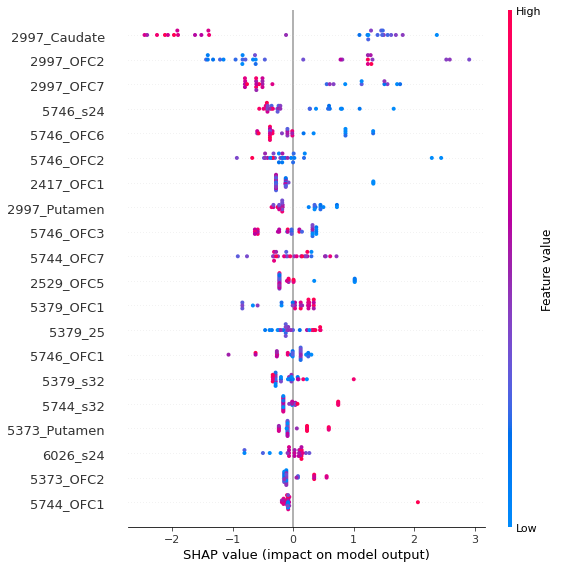

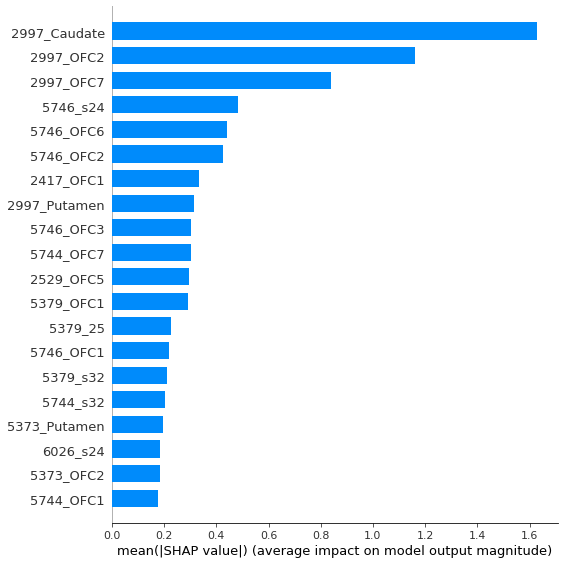


Fold  7


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 13.67396393
bestIteration = 19


bestTest = 12.40313564
bestIteration = 19


bestTest = 12.59177023
bestIteration = 19


bestTest = 9.676409122
bestIteration = 10

Stopped by overfitting detector  (10 iterations wait)

bestTest = 9.147441839
bestIteration = 2


bestTest = 13.8312977
bestIteration = 19


bestTest = 12.60120662
bestIteration = 19


bestTest = 12.24292198
bestIteration = 19


bestTest = 11.28966575
bestIteration = 19


bestTest = 10.19674613
bestIteration = 11


bestTest = 13.91054193
bestIteration = 19


bestTest = 12.71642714
bestIteration = 19


bestTest = 12.10519375
bestIteration = 19


bestTest = 11.27288545
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 9.608058326
bestIteration = 5


bestTest = 14.01267259
bestIteration = 19


bestTest = 12.90081036
bestIteration = 19


bestTest = 12.32096685
bestIteration = 19


bestTest = 10.87921277
bestIteration = 19


bestTest = 10.23664987
bestIteration = 11


bestTest = 14.

bestTest = 10.14289414
bestIteration = 39


bestTest = 8.658294183
bestIteration = 39


bestTest = 14.0206895
bestIteration = 39


bestTest = 13.19952055
bestIteration = 39


bestTest = 12.53049609
bestIteration = 39


bestTest = 9.442799816
bestIteration = 39


bestTest = 10.24389384
bestIteration = 39


bestTest = 13.08960489
bestIteration = 59


bestTest = 11.85120412
bestIteration = 58


bestTest = 10.89757512
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 10.51666396
bestIteration = 5

Stopped by overfitting detector  (10 iterations wait)

bestTest = 9.468362963
bestIteration = 4


bestTest = 13.77116807
bestIteration = 59


bestTest = 12.55362816
bestIteration = 58

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.90980366
bestIteration = 33


bestTest = 9.687150684
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 10.69442951
bestIteration = 1


bestTest = 13.79588652
bestIteration = 5


bestTest = 13.75415508
bestIteration = 99


bestTest = 12.24080998
bestIteration = 99


bestTest = 11.03556059
bestIteration = 96


bestTest = 9.536389527
bestIteration = 99

Stopped by overfitting detector  (10 iterations wait)

bestTest = 10.82267309
bestIteration = 3


bestTest = 13.81138169
bestIteration = 99


bestTest = 12.73183779
bestIteration = 99


bestTest = 11.16526724
bestIteration = 99


bestTest = 10.36565906
bestIteration = 99


bestTest = 9.63180096
bestIteration = 99

Gridresults:  {'params': {'depth': 6, 'learning_rate': 1, 'l2_leaf_reg': 7, 'iterations': 100}, 'cv_results': defaultdict(<class 'list'>, {'iterations': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 

75:	learn: 0.0002669	total: 161ms	remaining: 50.9ms
76:	learn: 0.0002336	total: 163ms	remaining: 48.8ms
77:	learn: 0.0002044	total: 165ms	remaining: 46.7ms
78:	learn: 0.0001788	total: 168ms	remaining: 44.5ms
79:	learn: 0.0001565	total: 170ms	remaining: 42.4ms
80:	learn: 0.0001369	total: 172ms	remaining: 40.3ms
81:	learn: 0.0001198	total: 174ms	remaining: 38.1ms
82:	learn: 0.0001048	total: 176ms	remaining: 36ms
83:	learn: 0.0000917	total: 178ms	remaining: 33.9ms
84:	learn: 0.0000803	total: 180ms	remaining: 31.8ms
85:	learn: 0.0000702	total: 182ms	remaining: 29.7ms
86:	learn: 0.0000614	total: 184ms	remaining: 27.6ms
87:	learn: 0.0000538	total: 186ms	remaining: 25.4ms
88:	learn: 0.0000470	total: 188ms	remaining: 23.3ms
89:	learn: 0.0000412	total: 191ms	remaining: 21.2ms
90:	learn: 0.0000360	total: 193ms	remaining: 19.1ms
91:	learn: 0.0000315	total: 195ms	remaining: 16.9ms
92:	learn: 0.0000276	total: 197ms	remaining: 14.8ms
93:	learn: 0.0000241	total: 199ms	remaining: 12.7ms
94:	learn: 0.0

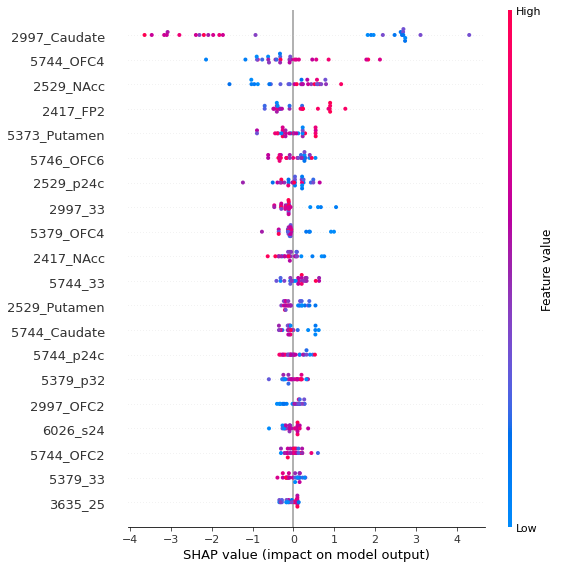

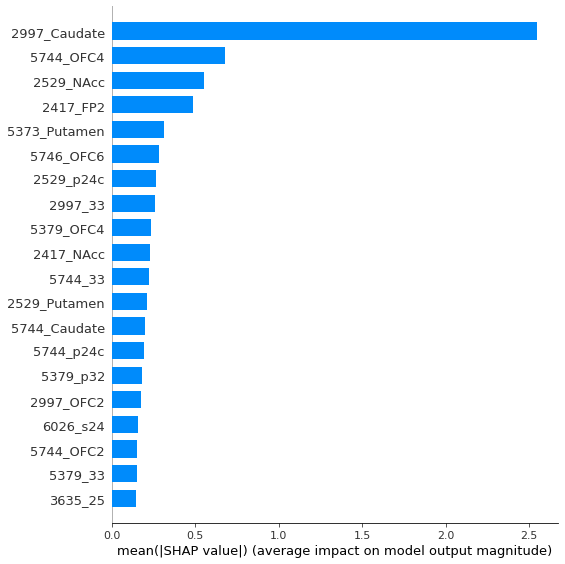


Fold  8


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 13.8241347
bestIteration = 19


bestTest = 12.21920402
bestIteration = 19


bestTest = 10.88770294
bestIteration = 15


bestTest = 10.35287805
bestIteration = 9

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.27514594
bestIteration = 2


bestTest = 14.08666894
bestIteration = 19


bestTest = 12.79540406
bestIteration = 19


bestTest = 11.90560939
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.53217657
bestIteration = 3


bestTest = 11.3726719
bestIteration = 19


bestTest = 14.17760278
bestIteration = 19


bestTest = 13.17773962
bestIteration = 19


bestTest = 12.25732657
bestIteration = 19


bestTest = 10.14321994
bestIteration = 18

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.95105933
bestIteration = 1


bestTest = 14.25438104
bestIteration = 19


bestTest = 13.33174458
bestIteration = 19


bestTest = 12.6447933
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)


bestTest = 14.37772231
bestIteration = 19


bestTest = 13.86974472
bestIteration = 19


bestTest = 13.42322648
bestIteration = 19


bestTest = 13.03666232
bestIteration = 16

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.61897813
bestIteration = 8


bestTest = 13.72169595
bestIteration = 39


bestTest = 12.64779959
bestIteration = 39


bestTest = 12.98726131
bestIteration = 39

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.77117477
bestIteration = 1

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.13334862
bestIteration = 1


bestTest = 14.00638614
bestIteration = 39


bestTest = 13.00220948
bestIteration = 39


bestTest = 12.70313169
bestIteration = 37

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.14437277
bestIteration = 6

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.87123079
bestIteration = 6


bestTest = 14.13554173
bestIteration = 39


bestTest = 13.12342243
bestIte


bestTest = 13.80884516
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.07567298
bestIteration = 41

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.48580872
bestIteration = 48


bestTest = 12.81115053
bestIteration = 59


bestTest = 14.35590679
bestIteration = 59


bestTest = 14.05720393
bestIteration = 59


bestTest = 13.28725562
bestIteration = 59


bestTest = 12.6099223
bestIteration = 52


bestTest = 11.74431296
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 10.79663351
bestIteration = 6


bestTest = 14.15166789
bestIteration = 57


bestTest = 13.35365918
bestIteration = 56


bestTest = 13.00994982
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.46048087
bestIteration = 11

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.6573818
bestIteration = 39


bestTest = 14.18740037
bestIteration = 59


bestTest = 13.41953549
bestI

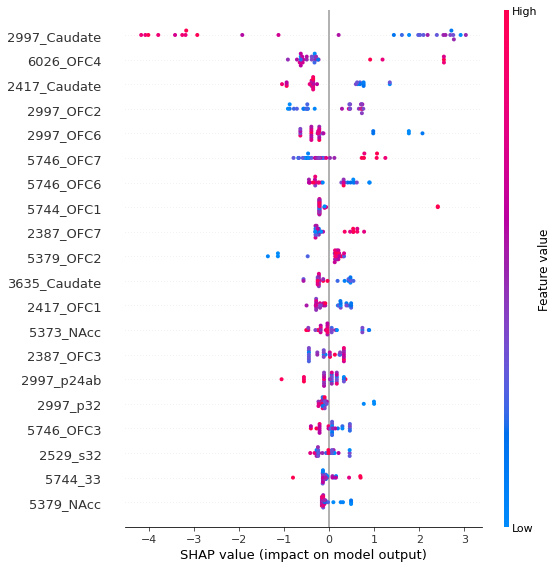

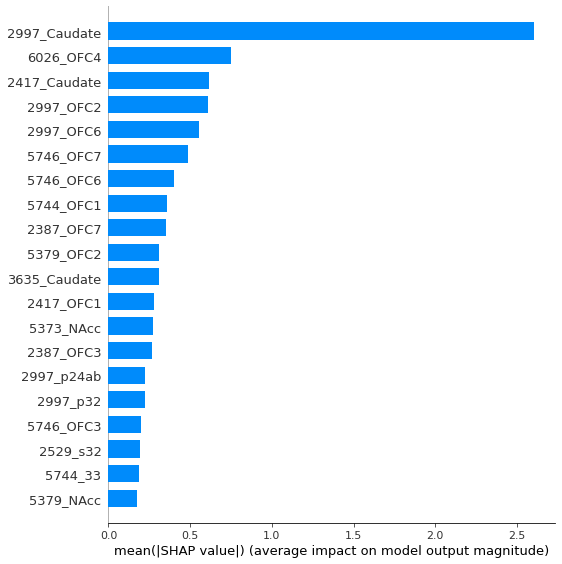


Fold  9


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 15.65813075
bestIteration = 19


bestTest = 13.55279547
bestIteration = 19


bestTest = 11.54041678
bestIteration = 19


bestTest = 11.22409392
bestIteration = 15

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.22035261
bestIteration = 6


bestTest = 15.93296295
bestIteration = 19


bestTest = 14.45140507
bestIteration = 19


bestTest = 13.45455319
bestIteration = 19


bestTest = 11.87685455
bestIteration = 19


bestTest = 13.60361669
bestIteration = 17


bestTest = 16.04557859
bestIteration = 19


bestTest = 15.09989392
bestIteration = 19


bestTest = 14.38870912
bestIteration = 19


bestTest = 11.18880384
bestIteration = 19


bestTest = 12.05893453
bestIteration = 19


bestTest = 16.10574554
bestIteration = 19


bestTest = 15.0996559
bestIteration = 19


bestTest = 14.76602553
bestIteration = 19


bestTest = 11.30356743
bestIteration = 19


bestTest = 10.28175454
bestIteration = 17


bestTest = 16.14359921
bestIteration = 19


bestTest = 15.26300309



bestTest = 13.96766577
bestIteration = 59


bestTest = 13.30655108
bestIteration = 59


bestTest = 13.05702721
bestIteration = 59


bestTest = 13.74145078
bestIteration = 59


bestTest = 15.68898591
bestIteration = 59


bestTest = 14.37304728
bestIteration = 59


bestTest = 13.15780812
bestIteration = 59


bestTest = 13.68105488
bestIteration = 59


bestTest = 11.51891183
bestIteration = 59


bestTest = 15.81548324
bestIteration = 59


bestTest = 14.23971352
bestIteration = 59


bestTest = 13.0048841
bestIteration = 59


bestTest = 12.93507538
bestIteration = 59


bestTest = 10.68743267
bestIteration = 59


bestTest = 15.88740889
bestIteration = 59


bestTest = 14.54947336
bestIteration = 59


bestTest = 13.11521327
bestIteration = 59


bestTest = 13.39104071
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.18198514
bestIteration = 21


bestTest = 14.60037639
bestIteration = 99


bestTest = 12.67168791
bestIteration = 99


bestTest = 12.91143583

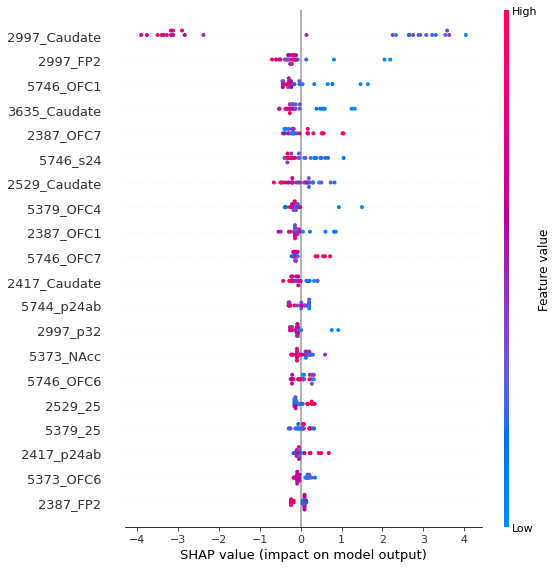

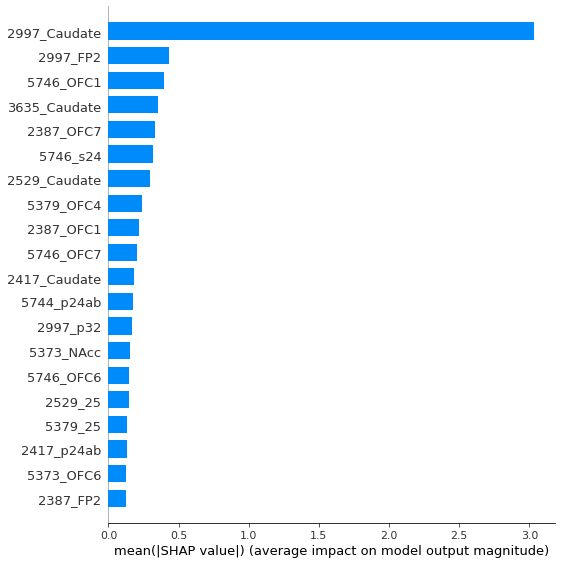

In [35]:
catboost_regressor(train_data, y_cad['CADSS'], 10)


Fold  0


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 6.629493123
bestIteration = 19


bestTest = 5.047069235
bestIteration = 18


bestTest = 5.293533502
bestIteration = 10


bestTest = 5.998515417
bestIteration = 14

Stopped by overfitting detector  (10 iterations wait)

bestTest = 6.598040885
bestIteration = 0


bestTest = 6.907707206
bestIteration = 19


bestTest = 5.343807301
bestIteration = 18


bestTest = 4.818895549
bestIteration = 18


bestTest = 5.102174669
bestIteration = 11

Stopped by overfitting detector  (10 iterations wait)

bestTest = 6.466709622
bestIteration = 0


bestTest = 7.071937131
bestIteration = 19


bestTest = 5.654234743
bestIteration = 18


bestTest = 4.828692205
bestIteration = 18

Stopped by overfitting detector  (10 iterations wait)

bestTest = 4.69264368
bestIteration = 7

Stopped by overfitting detector  (10 iterations wait)

bestTest = 6.04518881
bestIteration = 5


bestTest = 7.189278849
bestIteration = 19


bestTest = 6.013166552
bestIteration = 19


bestTest = 4.99695632
bestIteration = 18


bestTest = 6.615405674
bestIteration = 19


bestTest = 4.915704002
bestIteration = 19


bestTest = 3.335749782
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 4.094635169
bestIteration = 3


bestTest = 7.364289571
bestIteration = 19


bestTest = 6.688902881
bestIteration = 19


bestTest = 6.05918517
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 3.964565251
bestIteration = 6


bestTest = 3.755837717
bestIteration = 9


bestTest = 6.271484255
bestIteration = 39


bestTest = 4.883822277
bestIteration = 35

Stopped by overfitting detector  (10 iterations wait)

bestTest = 4.921382434
bestIteration = 21

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.121868265
bestIteration = 2


bestTest = 5.797849342
bestIteration = 39


bestTest = 6.87338285
bestIteration = 39


bestTest = 5.070685722
bestIteration = 39


bestTest = 3.722619263
bestIteration = 39


bestTest = 3.211191339
bestIteration = 39



bestTest = 5.010171446
bestIteration = 39


bestTest = 7.245721891
bestIteration = 39


bestTest = 6.319575279
bestIteration = 39


bestTest = 5.665027214
bestIteration = 39


bestTest = 5.109222975
bestIteration = 33

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.214248259
bestIteration = 17


bestTest = 6.402082548
bestIteration = 59


bestTest = 4.92522035
bestIteration = 57

Stopped by overfitting detector  (10 iterations wait)

bestTest = 4.766063626
bestIteration = 42

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.160634509
bestIteration = 2

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.696510465
bestIteration = 1


bestTest = 6.472885977
bestIteration = 59


bestTest = 5.045707327
bestIteration = 55

Stopped by overfitting detector  (10 iterations wait)

bestTest = 4.676401604
bestIteration = 43

Stopped by overfitting detector  (10 iterations wait)

bestTest = 5.429170785
bestIteration = 3

Stopped by overfitti

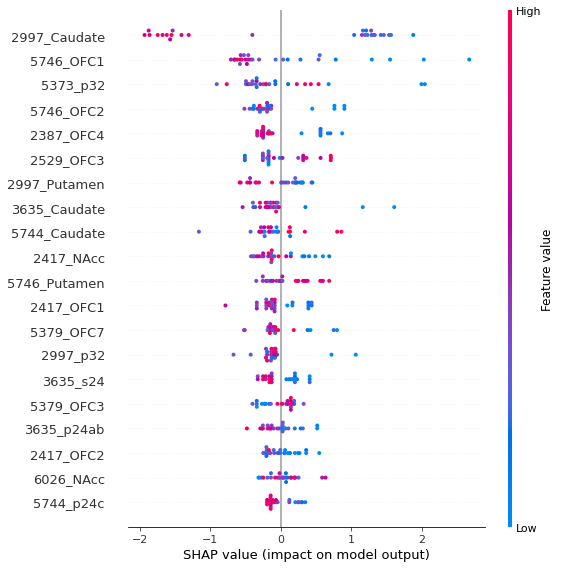

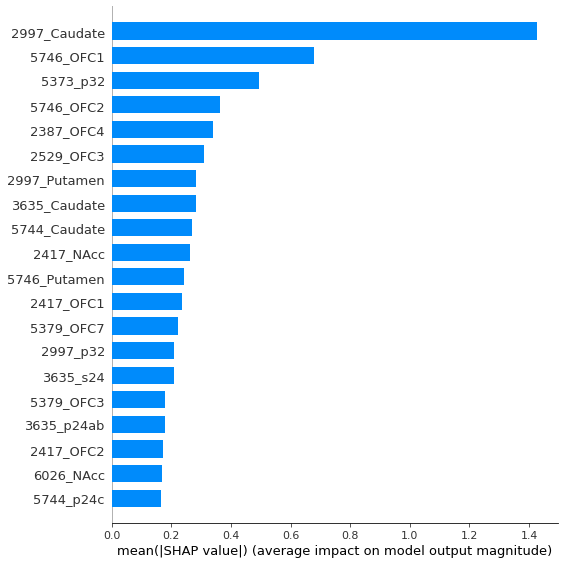


Fold  1


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 15.15777613
bestIteration = 19


bestTest = 13.51537346
bestIteration = 18


bestTest = 12.30497777
bestIteration = 16


bestTest = 13.0869772
bestIteration = 11

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.80459604
bestIteration = 3


bestTest = 15.41332898
bestIteration = 19


bestTest = 13.98923851
bestIteration = 19


bestTest = 12.77654059
bestIteration = 17


bestTest = 11.95343732
bestIteration = 19


bestTest = 13.37052299
bestIteration = 18


bestTest = 15.56243508
bestIteration = 19


bestTest = 14.30949189
bestIteration = 19


bestTest = 13.24829491
bestIteration = 19


bestTest = 10.2683397
bestIteration = 19


bestTest = 13.02457511
bestIteration = 18


bestTest = 15.62444872
bestIteration = 19


bestTest = 14.48318729
bestIteration = 19


bestTest = 13.54517826
bestIteration = 19


bestTest = 12.74989004
bestIteration = 19


bestTest = 11.85643758
bestIteration = 16


bestTest = 15.65907435
bestIteration = 19


bestTest = 14.59485303
b


bestTest = 11.24128125
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.42470229
bestIteration = 14


bestTest = 15.21466442
bestIteration = 59


bestTest = 13.21514216
bestIteration = 59


bestTest = 12.61864911
bestIteration = 59


bestTest = 10.65875739
bestIteration = 59


bestTest = 12.54442533
bestIteration = 59


bestTest = 15.36201159
bestIteration = 59


bestTest = 13.78670028
bestIteration = 59


bestTest = 12.90004674
bestIteration = 59


bestTest = 10.81096753
bestIteration = 59


bestTest = 11.04645902
bestIteration = 59


bestTest = 15.44448597
bestIteration = 59


bestTest = 13.94262596
bestIteration = 58


bestTest = 13.32515677
bestIteration = 59


bestTest = 10.10443011
bestIteration = 59


bestTest = 12.10945097
bestIteration = 59


bestTest = 14.01907573
bestIteration = 99


bestTest = 12.40047761
bestIteration = 99

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.05953193
bestIteration = 74


bestTest = 

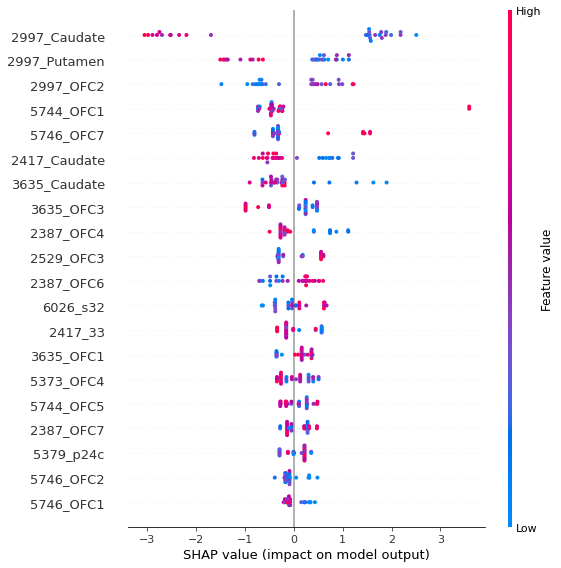

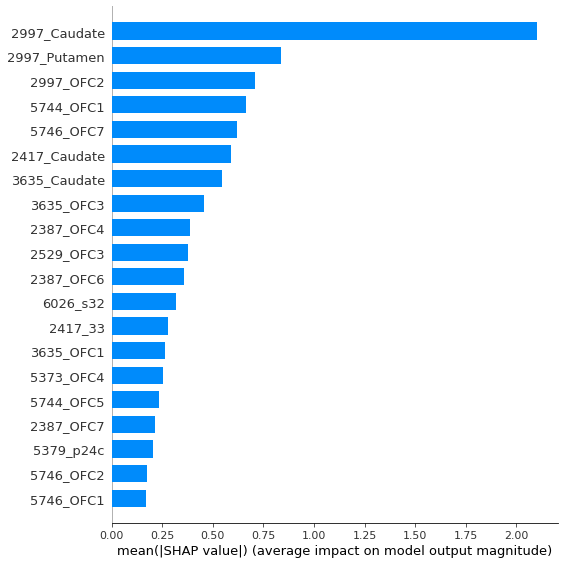


Fold  2


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 13.83103186
bestIteration = 19


bestTest = 12.20442075
bestIteration = 19


bestTest = 12.09667713
bestIteration = 13

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.38004758
bestIteration = 3

Stopped by overfitting detector  (10 iterations wait)

bestTest = 9.871615509
bestIteration = 1


bestTest = 14.06550415
bestIteration = 19


bestTest = 12.73861995
bestIteration = 19


bestTest = 12.46179122
bestIteration = 19


bestTest = 10.86604073
bestIteration = 14


bestTest = 10.58107572
bestIteration = 18


bestTest = 14.17987596
bestIteration = 19


bestTest = 12.99848401
bestIteration = 19


bestTest = 12.29097273
bestIteration = 19


bestTest = 10.45879452
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.34661913
bestIteration = 4


bestTest = 14.25865858
bestIteration = 19


bestTest = 13.18319481
bestIteration = 19


bestTest = 12.42952538
bestIteration = 19


bestTest = 10.78871144
bestIteration = 19

Stopp


bestTest = 12.92380675
bestIteration = 39


bestTest = 12.48797769
bestIteration = 29


bestTest = 11.02489354
bestIteration = 39


bestTest = 12.09343853
bestIteration = 38


bestTest = 14.25358357
bestIteration = 39


bestTest = 13.41067159
bestIteration = 39


bestTest = 13.07406478
bestIteration = 29


bestTest = 11.52772721
bestIteration = 39


bestTest = 11.7922507
bestIteration = 39


bestTest = 14.32627807
bestIteration = 39


bestTest = 13.60668267
bestIteration = 39


bestTest = 13.08880849
bestIteration = 29


bestTest = 11.24433535
bestIteration = 39


bestTest = 11.06026863
bestIteration = 39


bestTest = 14.36198885
bestIteration = 39


bestTest = 13.74223883
bestIteration = 39


bestTest = 12.78085284
bestIteration = 39


bestTest = 11.02655193
bestIteration = 39


bestTest = 11.9325704
bestIteration = 39


bestTest = 13.40957555
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.0268765
bestIteration = 26

Stopped by overfitting de


bestTest = 13.28246246
bestIteration = 99


bestTest = 12.71498594
bestIteration = 99


bestTest = 11.75796515
bestIteration = 99


bestTest = 11.34395731
bestIteration = 99

Gridresults:  {'params': {'depth': 4, 'learning_rate': 1, 'l2_leaf_reg': 9, 'iterations': 40}, 'cv_results': defaultdict(<class 'list'>, {'iterations': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39], 'test-RMSE-mean': [9.834790133385551, 9.581410026670081, 9.252521176728905, 8.625020483633469, 8.698450473440884, 8.296986702285121, 8.189058107672496, 7.978593983580742, 7.7071306332843506, 7.599527212730654, 7.4439320655009045, 7.307259852902929, 7.239761751881983, 7.2408605815227585, 7.187464705183535, 7.162637251544592, 7.134753973556488, 7.115360599386963, 7.107710925338878, 7.089379889510829, 7.075564694215404, 7.0742352802423385, 7.035357781174437, 7.032344982598633, 7.0336963020570575, 7.022641626502178, 7.

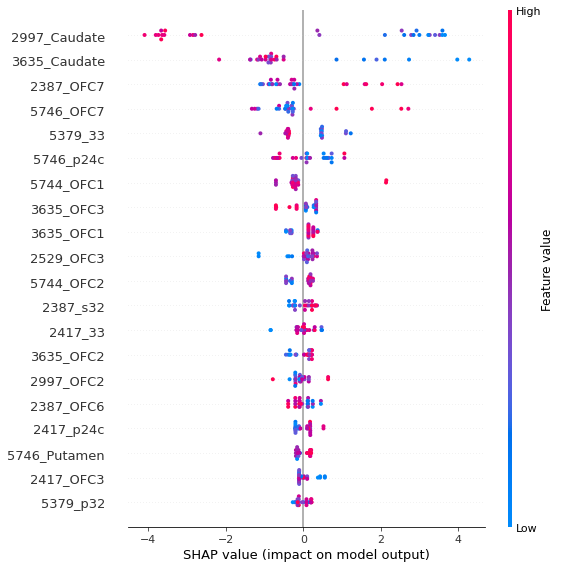

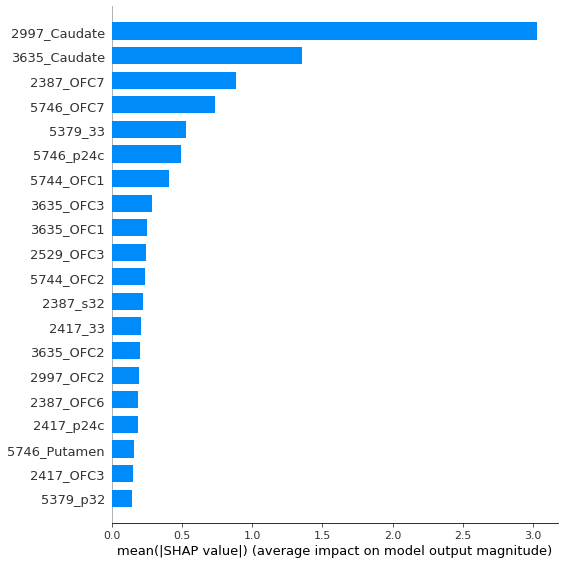


Fold  3


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 14.23831448
bestIteration = 19


bestTest = 12.76188102
bestIteration = 19


bestTest = 11.47974321
bestIteration = 16

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.09113868
bestIteration = 2

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.64935403
bestIteration = 0


bestTest = 14.40536328
bestIteration = 19


bestTest = 13.24930999
bestIteration = 18


bestTest = 12.23632176
bestIteration = 15


bestTest = 11.13145418
bestIteration = 18

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.89558093
bestIteration = 1


bestTest = 14.44583031
bestIteration = 19


bestTest = 13.08759896
bestIteration = 18


bestTest = 12.31307829
bestIteration = 18

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.86481209
bestIteration = 1


bestTest = 10.63143001
bestIteration = 11


bestTest = 14.53890396
bestIteration = 19


bestTest = 13.38963172
bestIteration = 19


bestTest = 12.56245431
bestIteration = 


bestTest = 12.17868333
bestIteration = 39


bestTest = 14.52872277
bestIteration = 39


bestTest = 13.85880545
bestIteration = 39


bestTest = 13.5433416
bestIteration = 39


bestTest = 11.46633216
bestIteration = 39


bestTest = 10.26445609
bestIteration = 39


bestTest = 14.61400319
bestIteration = 39


bestTest = 13.95362983
bestIteration = 39


bestTest = 13.44396167
bestIteration = 39


bestTest = 11.63389984
bestIteration = 39


bestTest = 11.66045746
bestIteration = 39


bestTest = 14.65155806
bestIteration = 39


bestTest = 14.01081102
bestIteration = 39


bestTest = 13.74235383
bestIteration = 39


bestTest = 11.04077314
bestIteration = 39


bestTest = 11.22680812
bestIteration = 39


bestTest = 13.83339063
bestIteration = 59


bestTest = 12.34376223
bestIteration = 59


bestTest = 11.90414035
bestIteration = 59


bestTest = 12.26978933
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.60444157
bestIteration = 2


bestTest = 14.26407829



bestTest = 12.57326575
bestIteration = 99


bestTest = 14.32338787
bestIteration = 99


bestTest = 13.20795054
bestIteration = 99


bestTest = 11.92635516
bestIteration = 99


bestTest = 10.29072716
bestIteration = 99


bestTest = 8.852648107
bestIteration = 99

Gridresults:  {'params': {'depth': 8, 'learning_rate': 1, 'l2_leaf_reg': 9, 'iterations': 100}, 'cv_results': defaultdict(<class 'list'>, {'iterations': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99], 'test-RMSE-mean': [11.383137293464696, 11.032724830090368, 10.690747378041635, 10.463281565839887, 10.119206499865616, 10.016043187801305, 9.655277696385742, 9.359971176942304, 9.196709838023

44:	learn: 0.0715947	total: 162ms	remaining: 198ms
45:	learn: 0.0644352	total: 165ms	remaining: 194ms
46:	learn: 0.0579917	total: 169ms	remaining: 191ms
47:	learn: 0.0521925	total: 173ms	remaining: 187ms
48:	learn: 0.0469733	total: 176ms	remaining: 183ms
49:	learn: 0.0422760	total: 180ms	remaining: 180ms
50:	learn: 0.0380484	total: 184ms	remaining: 176ms
51:	learn: 0.0342435	total: 188ms	remaining: 173ms
52:	learn: 0.0308192	total: 192ms	remaining: 171ms
53:	learn: 0.0277373	total: 196ms	remaining: 167ms
54:	learn: 0.0249635	total: 199ms	remaining: 163ms
55:	learn: 0.0224672	total: 203ms	remaining: 159ms
56:	learn: 0.0202205	total: 206ms	remaining: 155ms
57:	learn: 0.0181984	total: 209ms	remaining: 151ms
58:	learn: 0.0163786	total: 213ms	remaining: 148ms
59:	learn: 0.0147407	total: 216ms	remaining: 144ms
60:	learn: 0.0132666	total: 219ms	remaining: 140ms
61:	learn: 0.0119400	total: 223ms	remaining: 136ms
62:	learn: 0.0107460	total: 226ms	remaining: 133ms
63:	learn: 0.0096714	total: 229

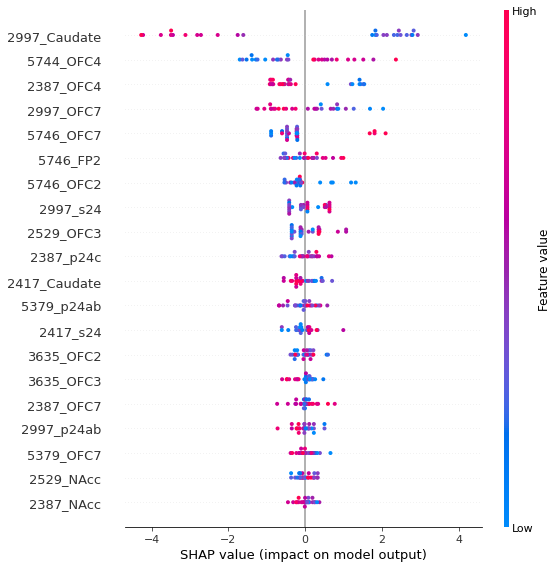

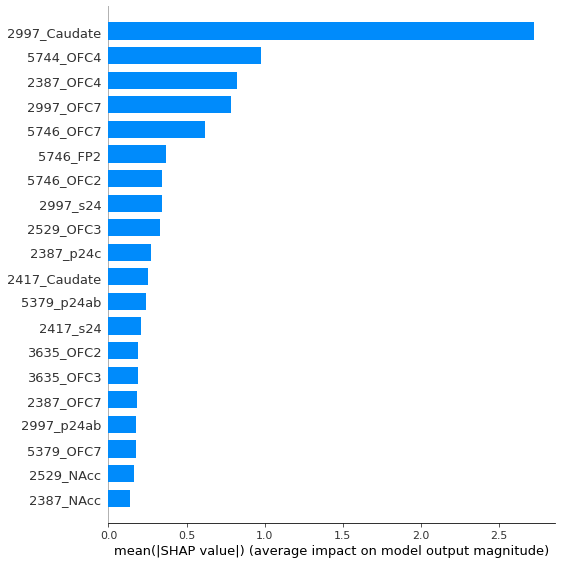


Fold  4


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 15.11598336
bestIteration = 19


bestTest = 13.66933619
bestIteration = 19


bestTest = 13.18630754
bestIteration = 19


bestTest = 9.847113032
bestIteration = 18


bestTest = 9.681917721
bestIteration = 10


bestTest = 15.29469631
bestIteration = 19


bestTest = 14.0956919
bestIteration = 19


bestTest = 13.58504322
bestIteration = 19


bestTest = 12.2018024
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.02819612
bestIteration = 1


bestTest = 15.40705222
bestIteration = 19


bestTest = 14.5537971
bestIteration = 19


bestTest = 13.90932863
bestIteration = 19


bestTest = 11.20835234
bestIteration = 17


bestTest = 11.54663376
bestIteration = 12


bestTest = 15.46976573
bestIteration = 19


bestTest = 14.67866499
bestIteration = 19


bestTest = 14.04838383
bestIteration = 19


bestTest = 10.53800955
bestIteration = 19


bestTest = 11.8377718
bestIteration = 13


bestTest = 15.510802
bestIteration = 19


bestTest = 14.81852259
bestI


bestTest = 13.82324272
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.68193446
bestIteration = 11

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.109981
bestIteration = 1


bestTest = 14.86073593
bestIteration = 59


bestTest = 13.60631324
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.81127766
bestIteration = 21


bestTest = 13.90260129
bestIteration = 59


bestTest = 13.93241663
bestIteration = 59


bestTest = 15.1162582
bestIteration = 59


bestTest = 13.85788665
bestIteration = 59


bestTest = 13.59057571
bestIteration = 59


bestTest = 12.99378488
bestIteration = 58


bestTest = 13.29086032
bestIteration = 59


bestTest = 15.18206718
bestIteration = 59


bestTest = 14.08750862
bestIteration = 59


bestTest = 13.58384743
bestIteration = 59


bestTest = 10.30569959
bestIteration = 59


bestTest = 12.07685237
bestIteration = 59


bestTest = 15.30495277
bestIteration = 59


bestT

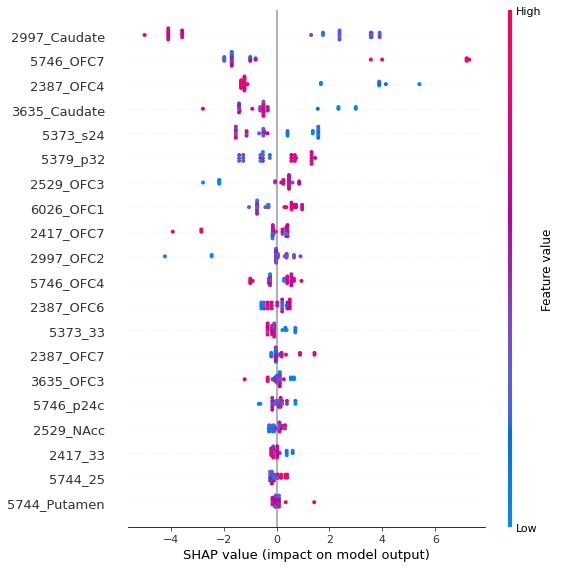

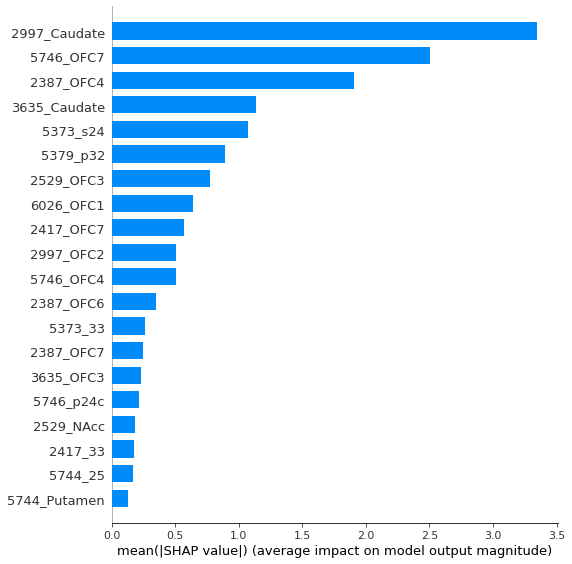


Fold  5


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 15.82362148
bestIteration = 19


bestTest = 14.26161643
bestIteration = 19


bestTest = 13.03286068
bestIteration = 19


bestTest = 11.42327541
bestIteration = 15

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.66190177
bestIteration = 4


bestTest = 15.92717293
bestIteration = 19


bestTest = 14.73355939
bestIteration = 19


bestTest = 13.52328697
bestIteration = 19


bestTest = 11.06803515
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.64182559
bestIteration = 6


bestTest = 16.02127744
bestIteration = 19


bestTest = 14.98294357
bestIteration = 19


bestTest = 14.00259833
bestIteration = 19


bestTest = 11.38177074
bestIteration = 19


bestTest = 13.08800486
bestIteration = 14


bestTest = 16.07379666
bestIteration = 19


bestTest = 15.09510252
bestIteration = 19


bestTest = 14.08074953
bestIteration = 19


bestTest = 11.72588107
bestIteration = 19


bestTest = 12.15724595
bestIteration = 16


bestTest = 16


bestTest = 15.61512817
bestIteration = 59


bestTest = 13.99655419
bestIteration = 57


bestTest = 13.46129419
bestIteration = 59


bestTest = 12.59967989
bestIteration = 59


bestTest = 13.77528586
bestIteration = 59


bestTest = 15.83828973
bestIteration = 59


bestTest = 13.88886632
bestIteration = 59


bestTest = 13.45830894
bestIteration = 59


bestTest = 13.36120607
bestIteration = 59


bestTest = 12.2436956
bestIteration = 59


bestTest = 15.90461511
bestIteration = 59


bestTest = 14.27832033
bestIteration = 59


bestTest = 13.68612017
bestIteration = 59


bestTest = 12.97747769
bestIteration = 59


bestTest = 12.41893935
bestIteration = 59


bestTest = 15.97264151
bestIteration = 59


bestTest = 14.9255029
bestIteration = 59


bestTest = 14.30158574
bestIteration = 59


bestTest = 13.3466654
bestIteration = 59


bestTest = 11.72300868
bestIteration = 59


bestTest = 14.89614787
bestIteration = 99


bestTest = 12.91518489
bestIteration = 98


bestTest = 12.46989816
bestIterati

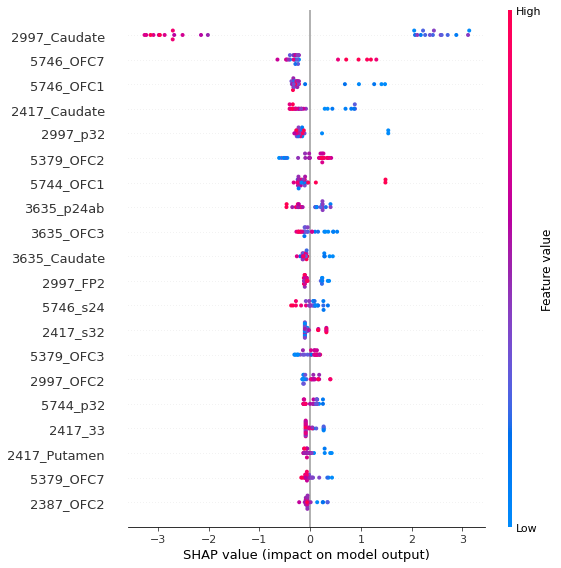

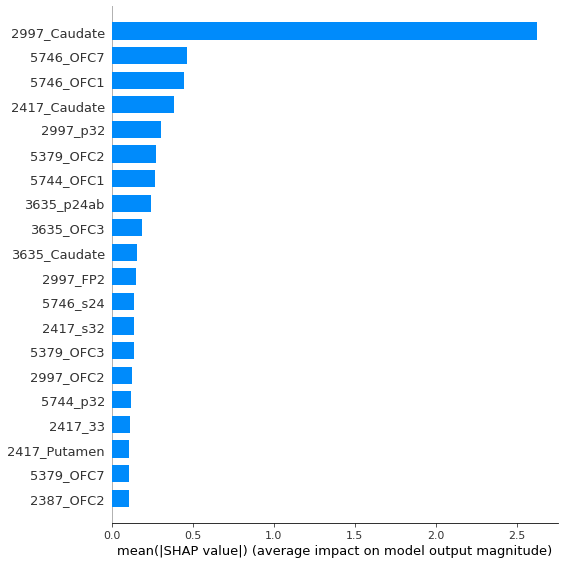


Fold  6


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 15.18488408
bestIteration = 19


bestTest = 13.80833974
bestIteration = 19


bestTest = 13.56441219
bestIteration = 15


bestTest = 12.36933409
bestIteration = 13

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.87161072
bestIteration = 2


bestTest = 15.3653241
bestIteration = 19


bestTest = 14.15622416
bestIteration = 19


bestTest = 13.63279008
bestIteration = 19


bestTest = 12.62237603
bestIteration = 18


bestTest = 13.23686227
bestIteration = 13


bestTest = 15.45133746
bestIteration = 19


bestTest = 14.45712892
bestIteration = 19


bestTest = 13.85539914
bestIteration = 19


bestTest = 12.23255527
bestIteration = 17


bestTest = 10.31315261
bestIteration = 9


bestTest = 15.49189757
bestIteration = 19


bestTest = 14.63097887
bestIteration = 19


bestTest = 14.13359653
bestIteration = 19


bestTest = 11.45207778
bestIteration = 18


bestTest = 11.71031778
bestIteration = 18


bestTest = 15.52952166
bestIteration = 19


bestTest = 14.85041167
b


bestTest = 15.45940491
bestIteration = 39


bestTest = 14.61319341
bestIteration = 39


bestTest = 14.20357225
bestIteration = 39

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.80430537
bestIteration = 18


bestTest = 11.49106308
bestIteration = 39


bestTest = 15.41703344
bestIteration = 39


bestTest = 14.49601889
bestIteration = 39


bestTest = 13.98215992
bestIteration = 38


bestTest = 11.61350979
bestIteration = 39


bestTest = 12.59248716
bestIteration = 39


bestTest = 14.79663302
bestIteration = 59


bestTest = 13.45092933
bestIteration = 59


bestTest = 13.13942176
bestIteration = 57

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.64467818
bestIteration = 13

Stopped by overfitting detector  (10 iterations wait)

bestTest = 15.21354637
bestIteration = 7


bestTest = 15.08974415
bestIteration = 59


bestTest = 13.90673
bestIteration = 59


bestTest = 13.66137324
bestIteration = 59

Stopped by overfitting detector  (10 iterations wa

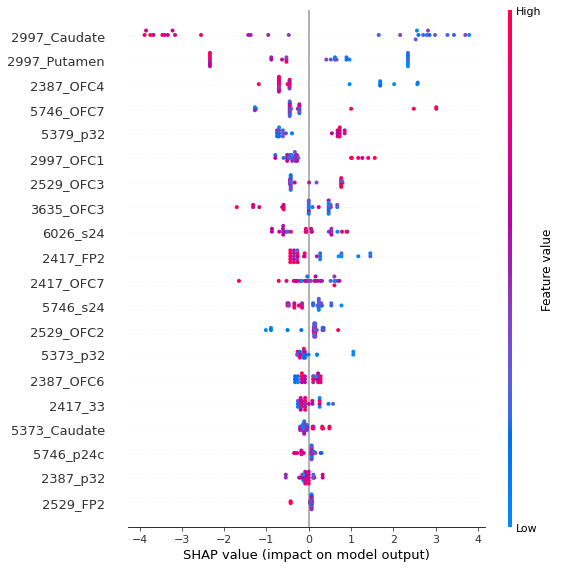

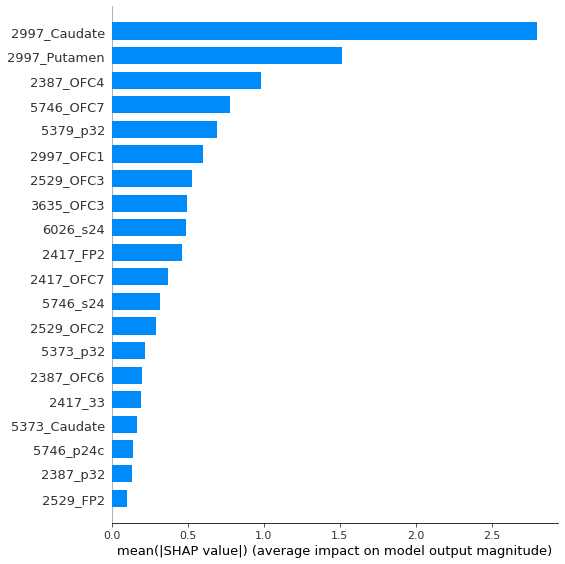


Fold  7


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 13.74197174
bestIteration = 19


bestTest = 12.59137525
bestIteration = 19


bestTest = 12.2111043
bestIteration = 11


bestTest = 11.58998544
bestIteration = 13

Stopped by overfitting detector  (10 iterations wait)

bestTest = 11.0505386
bestIteration = 1


bestTest = 13.87083527
bestIteration = 19


bestTest = 12.75944519
bestIteration = 19


bestTest = 12.17465322
bestIteration = 19


bestTest = 10.01380947
bestIteration = 17


bestTest = 10.5889732
bestIteration = 10


bestTest = 13.96514126
bestIteration = 19


bestTest = 12.95833856
bestIteration = 19


bestTest = 12.46502062
bestIteration = 19


bestTest = 9.106549466
bestIteration = 19


bestTest = 9.825098651
bestIteration = 11


bestTest = 14.01870015
bestIteration = 19


bestTest = 13.16069361
bestIteration = 19


bestTest = 12.54589997
bestIteration = 19


bestTest = 9.252778749
bestIteration = 19


bestTest = 9.095674262
bestIteration = 19


bestTest = 14.06577808
bestIteration = 19


bestTest = 13.34034314
be

bestTest = 12.69261567
bestIteration = 39


bestTest = 10.14721728
bestIteration = 39


bestTest = 10.55413898
bestIteration = 39


bestTest = 13.26426878
bestIteration = 59


bestTest = 11.99797774
bestIteration = 59


bestTest = 10.98655326
bestIteration = 59


bestTest = 10.18335816
bestIteration = 59

Stopped by overfitting detector  (10 iterations wait)

bestTest = 9.329069204
bestIteration = 3


bestTest = 13.72402407
bestIteration = 59


bestTest = 12.56027697
bestIteration = 59


bestTest = 11.74583186
bestIteration = 59


bestTest = 10.06730464
bestIteration = 59


bestTest = 10.27813687
bestIteration = 59


bestTest = 13.87047938
bestIteration = 59


bestTest = 12.9111209
bestIteration = 59


bestTest = 12.21836537
bestIteration = 59


bestTest = 9.677455017
bestIteration = 59


bestTest = 10.40032407
bestIteration = 59


bestTest = 13.88340607
bestIteration = 59


bestTest = 12.68134959
bestIteration = 59


bestTest = 11.87302219
bestIteration = 59

Stopped by overfitting de

41:	learn: 0.0921367	total: 158ms	remaining: 218ms
42:	learn: 0.0829230	total: 162ms	remaining: 214ms
43:	learn: 0.0746307	total: 169ms	remaining: 215ms
44:	learn: 0.0671676	total: 173ms	remaining: 211ms
45:	learn: 0.0604509	total: 176ms	remaining: 207ms
46:	learn: 0.0544058	total: 180ms	remaining: 203ms
47:	learn: 0.0489652	total: 184ms	remaining: 199ms
48:	learn: 0.0440687	total: 189ms	remaining: 197ms
49:	learn: 0.0396618	total: 193ms	remaining: 193ms
50:	learn: 0.0356956	total: 197ms	remaining: 190ms
51:	learn: 0.0321261	total: 201ms	remaining: 185ms
52:	learn: 0.0289135	total: 204ms	remaining: 181ms
53:	learn: 0.0260221	total: 208ms	remaining: 177ms
54:	learn: 0.0234199	total: 211ms	remaining: 173ms
55:	learn: 0.0210779	total: 214ms	remaining: 168ms
56:	learn: 0.0189701	total: 218ms	remaining: 164ms
57:	learn: 0.0170731	total: 221ms	remaining: 160ms
58:	learn: 0.0153658	total: 224ms	remaining: 156ms
59:	learn: 0.0138292	total: 228ms	remaining: 152ms
60:	learn: 0.0124463	total: 231

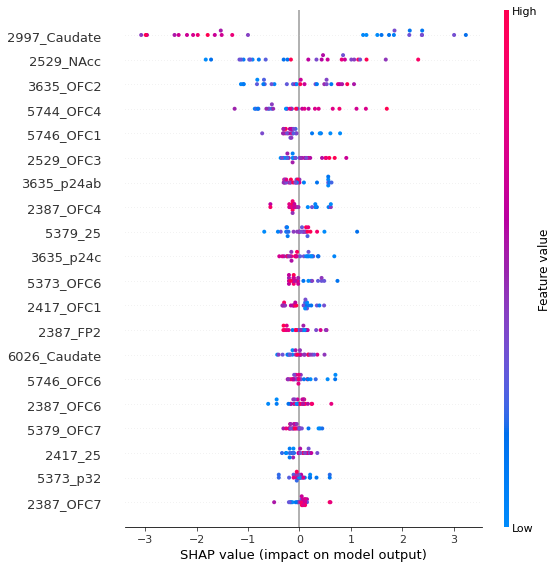

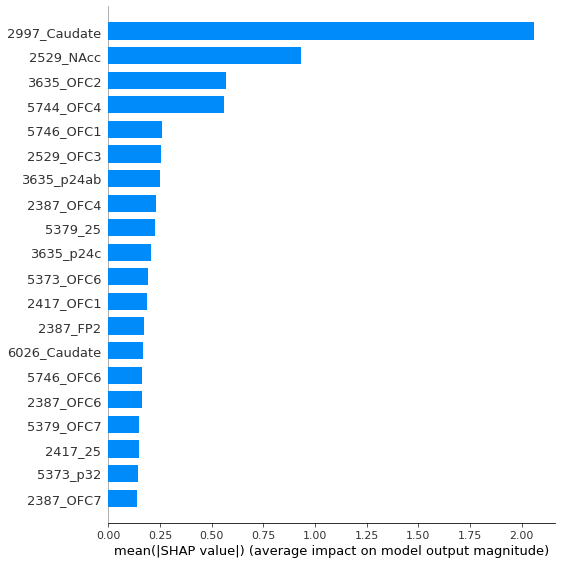


Fold  8


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))


bestTest = 13.85688825
bestIteration = 19


bestTest = 12.64710786
bestIteration = 19


bestTest = 12.73335214
bestIteration = 16

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.17780775
bestIteration = 1

Stopped by overfitting detector  (10 iterations wait)

bestTest = 16.30751928
bestIteration = 0


bestTest = 14.05419648
bestIteration = 19


bestTest = 12.98967943
bestIteration = 19


bestTest = 12.51412797
bestIteration = 19


bestTest = 12.45304853
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.33064225
bestIteration = 2


bestTest = 14.15870237
bestIteration = 19


bestTest = 13.23434141
bestIteration = 19


bestTest = 12.70603656
bestIteration = 19

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.66587279
bestIteration = 8

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.12395861
bestIteration = 6


bestTest = 14.2165271
bestIteration = 19


bestTest = 13.32349709
bestIter

bestTest = 13.3419967
bestIteration = 19


bestTest = 12.6539473
bestIteration = 19


bestTest = 12.14795636
bestIteration = 19


bestTest = 13.80969773
bestIteration = 39


bestTest = 12.50042645
bestIteration = 39

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.31687706
bestIteration = 27

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.13793103
bestIteration = 1

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.54924627
bestIteration = 2


bestTest = 14.10352835
bestIteration = 39


bestTest = 13.12977351
bestIteration = 39


bestTest = 12.48275051
bestIteration = 38


bestTest = 13.25580817
bestIteration = 38

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.93520497
bestIteration = 3


bestTest = 14.16823538
bestIteration = 39


bestTest = 13.27856088
bestIteration = 39


bestTest = 12.6841728
bestIteration = 39


bestTest = 13.03825034
bestIteration = 39


bestTest = 13.9209162
bestIteration = 39




bestTest = 14.22812136
bestIteration = 59


bestTest = 13.42642396
bestIteration = 57


bestTest = 12.99267485
bestIteration = 58

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.39650207
bestIteration = 22

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.72591404
bestIteration = 10


bestTest = 13.43396514
bestIteration = 99

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.95029298
bestIteration = 70

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.31129498
bestIteration = 37

Stopped by overfitting detector  (10 iterations wait)

bestTest = 13.48500261
bestIteration = 9

Stopped by overfitting detector  (10 iterations wait)

bestTest = 14.73900236
bestIteration = 5


bestTest = 13.77320207
bestIteration = 98

Stopped by overfitting detector  (10 iterations wait)

bestTest = 12.62429552
bestIteration = 81


bestTest = 12.5543047
bestIteration = 99

Stopped by overfitting detector  (10 iterations wait)

KeyboardInterrupt: 

In [26]:
catboost_regressor(train_data, y_cad['CADSS'], 10)

In [ ]:
    
    model.fit(train_pool)
    print("Prediction")
    preds=model.predict(train_pool)

    # get feature interaction
    fi = model.get_feature_importance(train_pool, type="Interaction")
    #preds = model.predict(train_pool)
    # preds_proba = model.predict_proba(test_data)
    # res = model.calc_feature_statistics(train_pool, feature=2)
    #print(res)
    #model.plot_tree(tree_idx=2, pool=None)
    #feat_imp=model.get_feature_importance(preds, type= "ShapValues")
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(train_data)
    # print(np.mean(shap_values, axis=1))
    #print(model.get_best_score())
    shap.summary_plot(shap_values, train_data)
    shap.summary_plot(shap_values, train_data, plot_type="bar")
    #shap.dependence_plot("2997_Caudate", shap_values, y_train)
    #plot_regression_results(list(range(len(preds))), preds, y_train, target)
    print("Random state: ", model.random_seed_)
    print("R squared train: ", model.score(train_data, y_train))
    print("Tree count: ", model.tree_count_)
    print("Learning rate: ", model.learning_rate_)
    plot_regression_results(list(range(len(preds))), preds, y_train, target)
    #print("R squared test: ", model.score(x_test, y_test))
    # plot_regression_coefficients(x_train, model.feature_importances_, n=10)


In [79]:
# input for cadss regression for ketamine
x_cad= pd.read_csv('C:/Users/canlab/Desktop/Test_Micha/testNotebook/Input_ket_CADSS_standardized.csv')
y_cad=pd.read_csv('C:/Users/canlab/Desktop/Test_Micha/testNotebook/Y_CADSS_ket.csv')

In [80]:
train_data=pd.read_csv('C:/Users/canlab/Desktop/Test_Micha/testNotebook/Input_ket_CADSS_standardized.csv')

In [ ]:
target=

In [81]:
excluded_num_cols = ['Unnamed: 0']
excluded_cat_cols= []

In [83]:
catboost_regressor(train_data, excluded_num_cols, excluded_cat_cols, 'target',test_data=None)

NameError: name 'find_variables' is not defined

In [4]:
# concat x and target
x_cad['target']=y_cad['CADSS'].copy()

In [6]:
train_pool = Pool(x_cad, 'target')

CatBoostError: Invalid label type=<class 'str'>: must be array like.

In [84]:
model = CatBoostRegressor(random_seed=0)
grid = {"iterations": [10, 40, 60, 100],
        "learning_rate": [0.01, 0.05, 0.1, 0.5, 1],
        "depth": [4, 6, 10],
        "l2_leaf_reg": [1, 3, 5, 7, 9]
        }

grid_result = model.grid_search(grid, X=x_cad, cv=5,  plot=True, verbose=False)


CatBoostError: y may be None only when X is an instance of catboost. Pool or string

In [11]:
feat_int=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Correlation_matrices/Feature_interaction.npy', allow_pickle=True)

In [13]:
feat_int_df=pd.DataFrame(feat_int)

In [42]:
feat_int_df.columns=['Feature pairs', 'score']

<IPython.core.display.Javascript object>


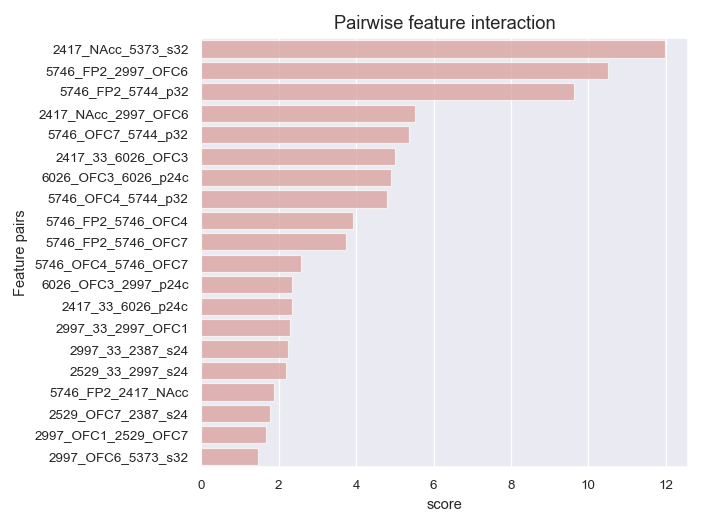

In [45]:
%matplotlib notebook
sns.set()
sns.set_context("paper")
sns.axes_style("ticks")
ax = sns.barplot(x="score", y="Feature pairs", data=feat_int_df.iloc[:20],color="salmon", saturation=.5, alpha=0.7)

plt.title('Pairwise feature interaction', fontsize=12)
plt.tight_layout()
plt.savefig('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Interaction_plot_catboost')

In [21]:
train_data=pd.read_csv('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/train_data.csv')

In [26]:
train_data

,Unnamed: 0,5746_25,6026_25,5744_25,5379_25,5373_25,2529_25,3635_25,2997_25,2387_25,...,5746_s32,6026_s32,5744_s32,5379_s32,5373_s32,2529_s32,3635_s32,2997_s32,2387_s32,2417_s32
0,0,0.080754,0.190333,0.929657,-0.700847,-1.019170,-0.704803,-0.542567,0.053024,-0.985108,...,-0.516708,0.262513,0.230023,0.181700,-1.299156,-0.367029,0.223769,0.679025,-0.332973,0.320166
1,1,0.023088,0.654398,0.935484,-0.678420,-0.802763,-0.252052,-0.968072,-0.802526,-0.981082,...,0.587512,-0.890869,-0.254998,0.073980,1.086021,-0.073576,0.178494,-0.615287,-0.424351,0.395442
2,2,0.028632,0.359817,-0.391878,-0.874543,0.232622,-0.911904,0.484598,0.009072,0.513476,...,-0.321585,-0.333410,-0.857593,0.008259,-0.249855,0.276207,-0.614523,-0.042155,-0.023040,-0.189156
3,3,-0.131350,-0.450513,1.725240,1.463272,-0.280427,0.928350,2.743382,0.879090,-1.554837,...,-0.208048,0.441469,1.259124,1.363093,-0.672614,0.620291,-0.467114,0.803814,-0.139917,-0.171964
4,4,-0.901021,1.465850,0.904596,0.047803,-0.644389,-2.562106,0.384758,-0.862184,-0.005775,...,-0.230110,1.551339,0.374112,1.474913,0.378451,-0.154076,2.239496,1.880667,0.908705,0.286139
5,5,-0.493475,-0.724875,-1.150669,-0.287052,0.416146,-1.211524,-0.449846,-0.258190,0.197360,...,0.220638,-1.098936,1.016707,0.278537,-0.499403,-1.153817,-1.270706,-0.591310,0.217787,0.202071
6,6,-1.876550,-1.337528,0.292838,-1.316130,-0.805687,1.385988,0.088953,0.522919,0.897957,...,-1.193147,0.745938,0.043224,-1.634982,-1.319975,0.393097,0.283063,0.005958,1.002666,1.447251
7,7,-1.157964,-0.657137,0.462216,1.260910,0.008568,-0.362588,0.205579,0.535081,-0.679787,...,-0.294242,-1.085818,0.308436,0.311466,-0.634355,-0.407370,1.577965,-1.402025,0.271108,-0.039570
8,8,-0.497645,-1.247423,0.433119,-0.578375,0.423220,0.344242,0.262433,-0.559700,0.564594,...,0.071527,-1.551079,0.675152,-0.967030,-0.049765,-1.443343,1.222242,-0.982233,1.487515,3.688788
9,9,1.040245,2.367617,1.001326,0.113452,-1.957812,-0.106313,-0.045867,-0.126461,-0.374933,...,0.142575,2.352908,2.399536,-0.728315,-1.806886,-0.685813,-0.246049,0.428849,-1.309823,-1.157168


In [30]:
train_data.iloc[1]

Unnamed: 0    1.000000
5746_25       0.023088
6026_25       0.654398
5744_25       0.935484
5379_25      -0.678420
                ...   
2529_s32     -0.073576
3635_s32      0.178494
2997_s32     -0.615287
2387_s32     -0.424351
2417_s32      0.395442
Name: 1, Length: 181, dtype: float64

In [34]:
train_data=train_data.drop(columns=['Unnamed: 0'])

In [35]:
train_data

,5746_25,6026_25,5744_25,5379_25,5373_25,2529_25,3635_25,2997_25,2387_25,2417_25,...,5746_s32,6026_s32,5744_s32,5379_s32,5373_s32,2529_s32,3635_s32,2997_s32,2387_s32,2417_s32
0,0.080754,0.190333,0.929657,-0.700847,-1.019170,-0.704803,-0.542567,0.053024,-0.985108,-0.603843,...,-0.516708,0.262513,0.230023,0.181700,-1.299156,-0.367029,0.223769,0.679025,-0.332973,0.320166
1,0.023088,0.654398,0.935484,-0.678420,-0.802763,-0.252052,-0.968072,-0.802526,-0.981082,-0.031534,...,0.587512,-0.890869,-0.254998,0.073980,1.086021,-0.073576,0.178494,-0.615287,-0.424351,0.395442
2,0.028632,0.359817,-0.391878,-0.874543,0.232622,-0.911904,0.484598,0.009072,0.513476,0.770034,...,-0.321585,-0.333410,-0.857593,0.008259,-0.249855,0.276207,-0.614523,-0.042155,-0.023040,-0.189156
3,-0.131350,-0.450513,1.725240,1.463272,-0.280427,0.928350,2.743382,0.879090,-1.554837,-0.065543,...,-0.208048,0.441469,1.259124,1.363093,-0.672614,0.620291,-0.467114,0.803814,-0.139917,-0.171964
4,-0.901021,1.465850,0.904596,0.047803,-0.644389,-2.562106,0.384758,-0.862184,-0.005775,-0.985063,...,-0.230110,1.551339,0.374112,1.474913,0.378451,-0.154076,2.239496,1.880667,0.908705,0.286139
5,-0.493475,-0.724875,-1.150669,-0.287052,0.416146,-1.211524,-0.449846,-0.258190,0.197360,-1.032428,...,0.220638,-1.098936,1.016707,0.278537,-0.499403,-1.153817,-1.270706,-0.591310,0.217787,0.202071
6,-1.876550,-1.337528,0.292838,-1.316130,-0.805687,1.385988,0.088953,0.522919,0.897957,-0.280310,...,-1.193147,0.745938,0.043224,-1.634982,-1.319975,0.393097,0.283063,0.005958,1.002666,1.447251
7,-1.157964,-0.657137,0.462216,1.260910,0.008568,-0.362588,0.205579,0.535081,-0.679787,-0.015537,...,-0.294242,-1.085818,0.308436,0.311466,-0.634355,-0.407370,1.577965,-1.402025,0.271108,-0.039570
8,-0.497645,-1.247423,0.433119,-0.578375,0.423220,0.344242,0.262433,-0.559700,0.564594,2.518956,...,0.071527,-1.551079,0.675152,-0.967030,-0.049765,-1.443343,1.222242,-0.982233,1.487515,3.688788
9,1.040245,2.367617,1.001326,0.113452,-1.957812,-0.106313,-0.045867,-0.126461,-0.374933,-1.285604,...,0.142575,2.352908,2.399536,-0.728315,-1.806886,-0.685813,-0.246049,0.428849,-1.309823,-1.157168


In [25]:
train_data.iloc[1]

Unnamed: 0    1.000000
5746_25       0.023088
6026_25       0.654398
5744_25       0.935484
5379_25      -0.678420
                ...   
2529_s32     -0.073576
3635_s32      0.178494
2997_s32     -0.615287
2387_s32     -0.424351
2417_s32      0.395442
Name: 1, Length: 181, dtype: float64

In [5]:
shap0=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/shap0.npy', allow_pickle=True)

In [6]:
shap0

array([[ 1.36533876e-01,  2.03428853e-08,  6.50056039e-10, ...,
         0.00000000e+00,  8.20234527e-07,  1.82894797e-10],
       [-4.17747615e-02,  1.18979599e-08, -6.56787715e-10, ...,
         0.00000000e+00, -7.36033394e-07,  4.79402934e-11],
       [-7.89281675e-02,  1.18979599e-08, -3.44762763e-10, ...,
         0.00000000e+00, -7.36033394e-07, -2.05355119e-10],
       ...,
       [-4.17747615e-02,  7.23904154e-09, -3.44762763e-10, ...,
         0.00000000e+00, -5.06850963e-08, -2.05355119e-10],
       [ 1.36533876e-01,  1.18979599e-08, -3.44762763e-10, ...,
         0.00000000e+00, -7.36033394e-07,  2.62080714e-12],
       [-2.81309187e-02, -4.13795701e-09, -6.56787715e-10, ...,
         0.00000000e+00, -7.36033394e-07,  3.07672569e-10]])

In [8]:
x_cad

,Unnamed: 0,5746_25,6026_25,5744_25,5379_25,5373_25,2529_25,3635_25,2997_25,2387_25,...,6026_s32,5744_s32,5379_s32,5373_s32,2529_s32,3635_s32,2997_s32,2387_s32,2417_s32,target
0,0,0.080754,0.190333,0.929657,-0.700847,-1.019170,-0.704803,-0.542567,0.053024,-0.985108,...,0.262513,0.230023,0.181700,-1.299156,-0.367029,0.223769,0.679025,-0.332973,0.320166,35
1,1,0.023088,0.654398,0.935484,-0.678420,-0.802763,-0.252052,-0.968072,-0.802526,-0.981082,...,-0.890869,-0.254998,0.073980,1.086021,-0.073576,0.178494,-0.615287,-0.424351,0.395442,31
2,2,0.028632,0.359817,-0.391878,-0.874543,0.232622,-0.911904,0.484598,0.009072,0.513476,...,-0.333410,-0.857593,0.008259,-0.249855,0.276207,-0.614523,-0.042155,-0.023040,-0.189156,1
3,3,-0.131350,-0.450513,1.725240,1.463272,-0.280427,0.928350,2.743382,0.879090,-1.554837,...,0.441469,1.259124,1.363093,-0.672614,0.620291,-0.467114,0.803814,-0.139917,-0.171964,15
4,4,-0.901021,1.465850,0.904596,0.047803,-0.644389,-2.562106,0.384758,-0.862184,-0.005775,...,1.551339,0.374112,1.474913,0.378451,-0.154076,2.239496,1.880667,0.908705,0.286139,8
5,5,-0.493475,-0.724875,-1.150669,-0.287052,0.416146,-1.211524,-0.449846,-0.258190,0.197360,...,-1.098936,1.016707,0.278537,-0.499403,-1.153817,-1.270706,-0.591310,0.217787,0.202071,14
6,6,-1.876550,-1.337528,0.292838,-1.316130,-0.805687,1.385988,0.088953,0.522919,0.897957,...,0.745938,0.043224,-1.634982,-1.319975,0.393097,0.283063,0.005958,1.002666,1.447251,0
7,7,-1.157964,-0.657137,0.462216,1.260910,0.008568,-0.362588,0.205579,0.535081,-0.679787,...,-1.085818,0.308436,0.311466,-0.634355,-0.407370,1.577965,-1.402025,0.271108,-0.039570,11
8,8,-0.497645,-1.247423,0.433119,-0.578375,0.423220,0.344242,0.262433,-0.559700,0.564594,...,-1.551079,0.675152,-0.967030,-0.049765,-1.443343,1.222242,-0.982233,1.487515,3.688788,5
9,9,1.040245,2.367617,1.001326,0.113452,-1.957812,-0.106313,-0.045867,-0.126461,-0.374933,...,2.352908,2.399536,-0.728315,-1.806886,-0.685813,-0.246049,0.428849,-1.309823,-1.157168,20


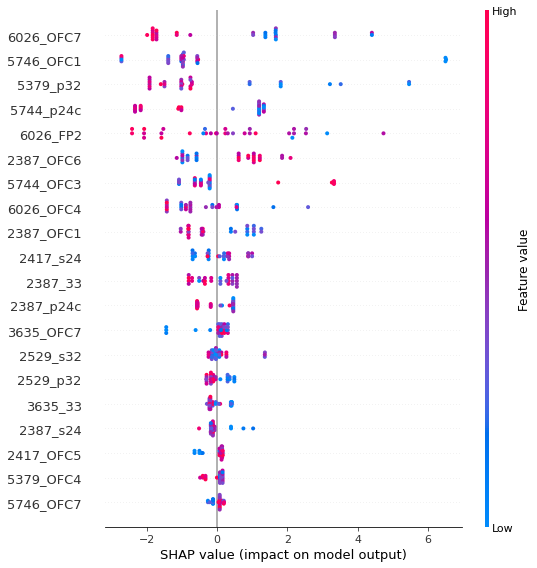

In [36]:
shap.summary_plot(shap0, train_data)


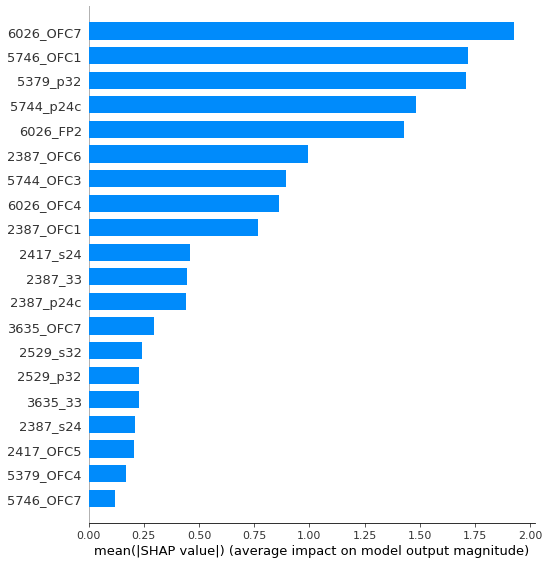

In [37]:
shap.summary_plot(shap0, train_data, plot_type="bar")

Load shap values

In [42]:
shap1=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/shap1.npy', allow_pickle=True)
shap2=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/shap2.npy', allow_pickle=True)
shap3=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/shap3.npy', allow_pickle=True)
shap4=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/shap4.npy', allow_pickle=True)
shap5=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/shap5.npy', allow_pickle=True)
shap6=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/shap6.npy', allow_pickle=True)
shap7=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/shap7.npy', allow_pickle=True)
shap8=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/shap8.npy', allow_pickle=True)
shap9=np.load('C:/Users/canlab/Desktop/Masterthesis_python/ReDoneAnalysis20200420/Regression_CADSS/Results/shap9.npy', allow_pickle=True)

In [58]:
list_shap=[shap0,shap1,shap2,shap3,shap4,shap5,shap6,shap7,shap8,shap9]

In [80]:
list_shap.shape

NameError: name 'list_shap' is not defined

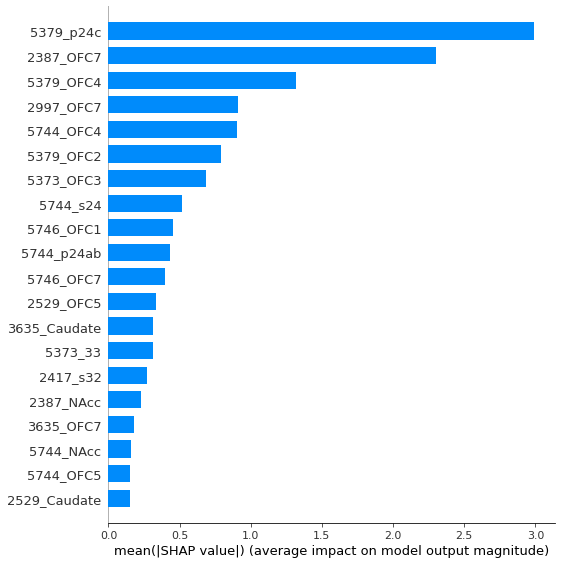

In [39]:
shap.summary_plot(shap1, train_data, plot_type="bar")

Mean shap value of all shaps

In [43]:
shap_cum=(shap0+shap1+shap2+shap3+shap4+shap5+shap6+shap7+shap8+shap9)/10

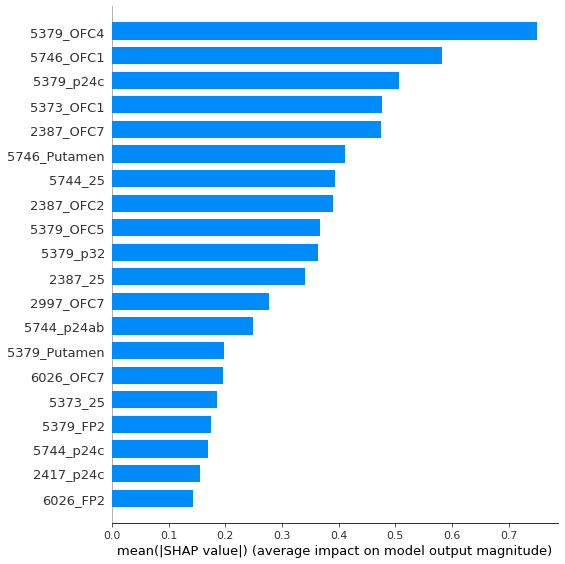

In [44]:
shap.summary_plot(shap_cum, train_data, plot_type="bar")

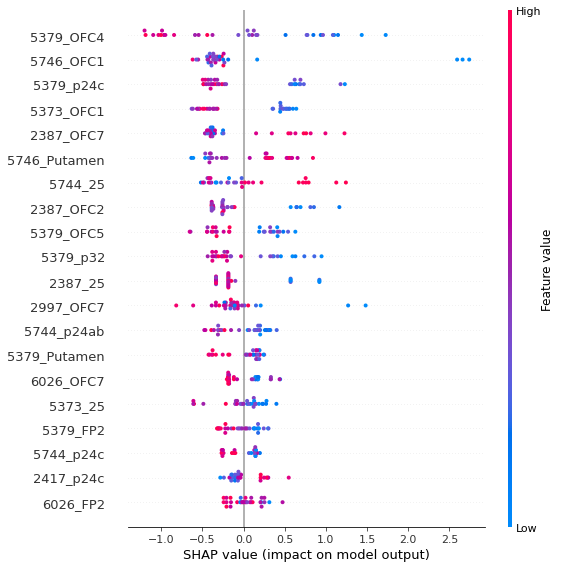

In [45]:
shap.summary_plot(shap_cum, train_data)

Median shap values

In [47]:
len(shap0[1])

180

In [67]:
shap1

array([[ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        , -0.09108616],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        , -0.268016  ],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.24915916],
       ...,
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.20589982],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.20589982],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.20589982]])

In [66]:
list_shap[1]

array([[ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        , -0.09108616],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        , -0.268016  ],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.24915916],
       ...,
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.20589982],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.20589982],
       [ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.20589982]])

In [62]:
list_shap[1][2]

array([ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        , -0.16861333,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
       -0.52531958,  0.1511986 ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        , -0.0053476 ,  0.        , -0.07672153,
        0.        ,  0.        , -0.01652161, -0.01765894,  0.        ,
       -0.25785819, -0.00853849,  0.        ,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        0.053528  , -0.03412324,  0.        , -0.82097643,  0.        ,
        0.        , -0.02719744,  0.        ,  0.04060821,  0.  

In [69]:
# 31 samples, 180 features, 10 shap values
# final shap matrix for median shap values
shap_cum=np.zeros((31,180))
# loop through samples
for i in range(len(shap0)):
    # loop through features
    for k in range(len(shap0[1])):
        shap_arr =np.zeros(10)
        for j in range (len(list_shap)):
            # bring them all in one array to calculate median along this axis 
            shap_arr[j]=copy.deepcopy(list_shap[j][i][k])
        # calculate median of all shap values    
        shap_median=np.median(shap_arr)
        # save median in cumulated shap value matrix
        shap_cum[i][k]=copy.deepcopy(shap_median)

In [70]:
shap_cum

array([[ 0.00000000e+00,  0.00000000e+00,  4.14560864e-01, ...,
         0.00000000e+00,  0.00000000e+00,  5.62143716e-03],
       [ 0.00000000e+00,  0.00000000e+00,  3.44339760e-01, ...,
         0.00000000e+00,  0.00000000e+00,  2.39701467e-11],
       [ 0.00000000e+00,  0.00000000e+00, -1.97736998e-02, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       ...,
       [ 0.00000000e+00,  0.00000000e+00, -1.41497485e-01, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 0.00000000e+00,  0.00000000e+00, -1.87270178e-01, ...,
         0.00000000e+00,  0.00000000e+00,  1.31040357e-12],
       [ 0.00000000e+00,  0.00000000e+00, -1.23070483e-02, ...,
         0.00000000e+00,  0.00000000e+00,  5.62365896e-02]])

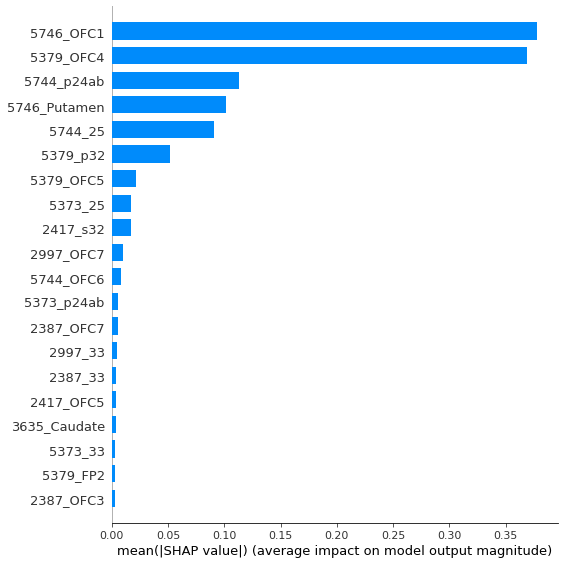

In [71]:
shap.summary_plot(shap_cum, train_data, plot_type="bar")

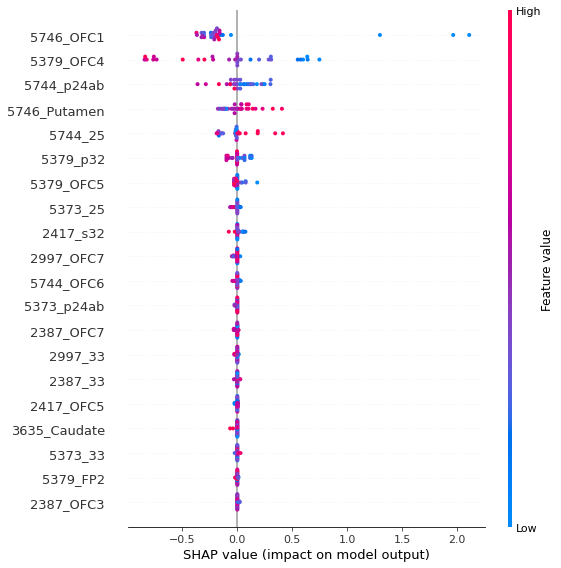

In [72]:
shap.summary_plot(shap_cum, train_data)

In [74]:
fi0

NameError: name 'fi0' is not defined